In [22]:
import os
import copy
import os.path 
import cv2
import tkinter as tk
import tkinter.filedialog as fd
from PIL import Image, ImageEnhance
from skimage import transform, img_as_int, exposure, img_as_ubyte
import skimage.io as io
import skimage as si
import tkinter.messagebox as mb
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import blob_log, blob_doh, blob_dog
from scipy import ndimage, spatial
from cmath import inf
import sys
import numpy as np
from scipy.optimize import curve_fit
import json
from Bio import SeqIO
from skimage.filters import gaussian
import pandas as pd
from skimage.feature import peak_local_max
from sklearn.metrics import mean_squared_error
from numpy.linalg import norm
from math import floor, ceil, exp
from skimage.registration import phase_cross_correlation
from scipy import ndimage as ndi
from scipy.io import savemat
import Polywarp
import itertools
import scipy.spatial
import star
from skimage.restoration import rolling_ball


root = tk.Tk()
root.attributes("-topmost", True)
root.withdraw()

''

## Was the data collected in the ALEX regime?
 

In [38]:
# ALEX = False
ALEX = True
#if ALEX:
#    green_frames = np.add(1,np.multiply(2,range(10)))
#    red_frames = np.subtract(green_frames,1)
 
    
if ALEX:
    red_frames = np.add(1,np.multiply(2,range(10)))
    green_frames= np.subtract(red_frames,1)    
    
    

## Choose the tile

In [39]:
current_tile = 1101

## Provide the matching coordinates for the tile

In [40]:
# DO NOT ERASE PREVIOUS COORDINATES. ADD NEW LINES AND LABEL THE EXPERIMENT


#240124_Ha_4N_ALEX_Tile_1
# coords_t_seq = np.array([-3009.476,234]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0,0])
#240124_Ha_4N_ALEX_Tile_2
# coords_t_seq = np.array([106.645,233.696]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0,0])

#230215_Tile_3
# coords_t_seq = np.array([2472.485,1187.175]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([9029.710,1510.853])


#2023-01-26 Tile 1
#coords_t_seq = np.array([1537.5,1398]) #Insert matching bead coordinates here manually!
#coords_t_FRET = np.array([6335,1470.5])
#2023-01-26 Tile 2
# coords_t_seq = np.array([1447.4,1449.7]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3118.5,1499.8])

#2023-01-23 Tile 1
# coords_t_seq = np.array([1505.5,1481.8]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([6893.9,1298.6])
#2023-01-23 Tile 2
# coords_t_seq = np.array([829,1559.8]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3111.6,1353.6])

#2022-12-27 Tile 1
# coords_t_seq = np.array([1451.532,1204.410]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3739.046,1271.476])
#2022-12-27 Tile 2
# coords_t_seq = np.array([2577.568,1054.075]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([1751.353,1126.065])

#2023-01-16 Tile 1
# coords_t_seq = np.array([2067,348]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([8813, 785]) 
#2023-01-16 Tile 2
# coords_t_seq = np.array([986,888]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([4644, 1300]) 

#2023-01-17 Tile 1
# coords_t_seq = np.array([1525.5,1810.6]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([7238, 970.6]) 
#2023-01-17 Tile 2
# coords_t_seq = np.array([1333.4,1987.6]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3971.3, 1154.7]) 


In [41]:
# Initial match smFRET vs Seq
# deltax = 4660 # for tile 1 220815
# deltay = -25
# upper_left_um_x = 26091.3
# upper_left_um_y = -690
# Select library sequences from the FASTQ data
def library_index(template, strings, min_matches):
    row_sums = [sum(a == b for a, b in zip(row, template)) for row in strings]
    # Create the index of elements from Seq where row_sums is above the threshold
    index = [i for i, row_sum in enumerate(row_sums) if row_sum > min_matches]
    return index

def get_pos(record):
    
    des = record.description
    tile_num = int(des.split(' ')[0].split(':')[4])
    x_pos = int(des.split(' ')[0].split(':')[5])
    y_pos = int(des.split(' ')[0].split(':')[6])
    return tile_num, x_pos, y_pos


def generate_img(x, y, x_min, y_min, x_max, y_max, r, blurred, sigma):
    # x_min = min(x)
    # x_max = max(x)
    # y_min = min(y)
    # y_max = max(y)
    x_range = x_max - x_min
    y_range = y_max - y_min
    # x_range = 27994
    # y_range = 27174
    img = np.zeros(shape=(x_range, y_range))
    for i in range(0, len(x)):
        img[min(x_range-1,max(0,int(x[i]-r))):min(x_range-1,max(0,int(x[i]+r+1))),min(y_range-1,max(0,int(y[i]-r))):min(y_range-1,max(0,int(y[i]+r+1)))] = 200

    if blurred:
        img = gaussian(img, sigma=sigma)
    im = Image.fromarray(img)
    new_im = im.convert("L")
#     new_im.save(op_path)
    return new_im


def generate_with_marker(x, y, marker_x, marker_y, op_path, csv_path):
    x_min = min(x)
    x_max = max(x)
    y_min = min(y)
    y_max = max(y)
    x_range = x_max - x_min + 1
    y_range = y_max - y_min + 1
    img = np.zeros(shape=(x_range, y_range, 3))
    marker_dic = {'index': range(0, len(marker_x)), 'x': [], 'y': []}
    for i in range(0, len(x)):
        for j in range(0, 5):
            for k in range(0, 5):
                img[max(0, x[i] - x_min - j),
                    max(0, y[i] - y_min - k), 0:3] = 255
                img[min(x_range - 1, x[i] - x_min + j),
                    max(0, y[i] - y_min - k), 0:3] = 255
                img[min(x_range - 1, x[i] - x_min + j),
                    min(y_range - 1, y[i] - y_min + k), 0:3] = 255
                img[max(0, x[i] - x_min - j),
                    min(y_range - 1, y[i] - y_min + k), 0:3] = 255
    for i in range(0, len(marker_x)):
        marker_dic['x'].append(marker_x[i] - x_min)
        marker_dic['y'].append(marker_y[i] - y_min)
        for j in range(0, 5):
            for k in range(0, 5):
                img[max(0, marker_x[i] - x_min - j),
                    max(0, marker_y[i] - y_min - k), 0] = 255
                img[max(0, marker_x[i] - x_min - j),
                    max(0, marker_y[i] - y_min - k), 1:3] = 0
                img[min(x_range - 1, marker_x[i] - x_min + j),
                    max(0, marker_y[i] - y_min - k), 0] = 255
                img[min(x_range - 1, marker_x[i] - x_min + j),
                    max(0, marker_y[i] - y_min - k), 1:3] = 0
                img[min(x_range - 1, marker_x[i] - x_min + j),
                    min(y_range - 1, marker_y[i] - y_min + k), 0] = 255
                img[min(x_range - 1, marker_x[i] - x_min + j),
                    min(y_range - 1, marker_y[i] - y_min + k), 1:3] = 0
                img[max(0, marker_x[i] - x_min - j),
                    min(y_range - 1, marker_y[i] - y_min + k), 0] = 255
                img[max(0, marker_x[i] - x_min - j),
                    min(y_range - 1, marker_y[i] - y_min + k), 1:3] = 0
    blurred_img = gaussian(img, sigma=3, multichannel=True)
    im = Image.fromarray(blurred_img.astype(np.uint8))
    new_im = im.convert("P")
    new_im.save(op_path)
    df = pd.DataFrame(marker_dic)
    df.to_csv(csv_path, index=True, header=True)


def get_coordinates(fastq_path):
    x_coordinate_01 = []
    y_coordinate_01 = []
    x_coordinate_02 = []
    y_coordinate_02 = []
    for record in SeqIO.parse(fastq_path, "fastq"):
        if record is not None:
            tile_num, x_pos, y_pos = get_pos(record)
            seq = str(record.seq)
            if tile_num == 1101:
                x_coordinate_01.append(x_pos)
                y_coordinate_01.append(y_pos)
            elif tile_num == 1102:
                x_coordinate_02.append(x_pos)
                y_coordinate_02.append(y_pos)
#     print('Coordinates are found.')
    return x_coordinate_01, y_coordinate_01, x_coordinate_02, y_coordinate_02


def get_xy_coordinates(fastq_path, with_seq):
    x_coordinate_01 = []
    y_coordinate_01 = []
    x_coordinate_02 = []
    y_coordinate_02 = []
    x_seq_coordinate_01 = []
    y_seq_coordinate_01 = []
    x_seq_coordinate_02 = []
    y_seq_coordinate_02 = []
    for record in SeqIO.parse(fastq_path, "fastq"):
        if record is not None:
            tile_num, x_pos, y_pos = get_pos(record)
            seq = str(record.seq)
            if tile_num == 1101:
                if with_seq != seq:
                    x_coordinate_01.append(x_pos)
                    y_coordinate_01.append(y_pos)
                else:
                    x_seq_coordinate_01.append(x_pos)
                    y_seq_coordinate_01.append(y_pos)
            elif tile_num == 1102:
                if with_seq != seq:
                    x_coordinate_02.append(x_pos)
                    y_coordinate_02.append(y_pos)
                else:
                    x_seq_coordinate_02.append(x_pos)
                    y_seq_coordinate_02.append(y_pos)
#     print('Coordinates are found.')
    return x_coordinate_01, y_coordinate_01, \
        x_coordinate_02, y_coordinate_02, \
        x_seq_coordinate_01, y_seq_coordinate_01, \
        x_seq_coordinate_02, y_seq_coordinate_02


def get_seq_coordinates(fastq_path, tile):
    x_coordinate = []
    y_coordinate = []
    sequences = []
    for record in SeqIO.parse(fastq_path, "fastq"):
        if record is not None:
            tile_num, x_pos, y_pos = get_pos(record)
            seq = str(record.seq)
            if tile_num == tile:
                x_coordinate.append(x_pos/10)
                y_coordinate.append(y_pos/10)
                sequences.append(seq)
#     print('Coordinates are found.')
    return x_coordinate, y_coordinate, sequences

def scaling_seq (x, y):
    
    x = int(deltax+(335-x_border)/2 + (x - upper_left_um_x)/0.34) # tile 2 06/09/2022;
    y = int(deltay+(150-y_border)/2  - (y - upper_left_um_y)/0.34)  # 305 and 154 are the size of tfd 512 by 256 image
#     
#     x = int(-850+(305-x_border)/2 + (x - 26384)/0.34) # tile 2 06/09/2022;
#     y = int(-385+(154-y_border)/2  - (y + 407.1)/0.34)  # 305 and 154 are the size of tfd 512 by 256 image
#     x = int(-3967+(305-x_border)/2 + (x - 26384)/0.34) # tile 1 06/09/2022; 
#     y = int(-405+(154-y_border)/2  - (y + 407.1)/0.34)   

#     x = int(1700+(330-x_border)/2  + (x - 27246.18)/0.34 ) ### tile 2 19/07/2022
#     y = int(1571+(170-y_border)/2 - (y + 1149.66)/0.34)
#     x = int(2329+(330-x_border)/2 + (x - 28522.9)/0.34)  ### tile 1 19/07/2022
#     y = int(2042+(170-y_border)/2 - (y + 1313.3)/0.34)

    
    
    return (x,y)
    

def blob_detection(img, min_sigma, max_sigma, threshold, method=0):
    """This function is mostly used for detecting the beads in any image.

    Args:
        img_path (string): The absolute path of the input image.
        min_sigma (int): The minimum sigma, lower it is, smaller the blob will be detected.
        max_sigma (int): The maximum sigma, higher it is, bigger the blob will be detected.
        threshold (float): Higher it is, higher the intensities of blobs.
        method (int, optional): 0 for Difference of Gaussian (DoG) and 1 for Determinant of Hessian (DoH). 
        They should be applied with different combination of parameters. DoG is more suitable for fret movies,
        while DoH is more suitable for sequencing images. Defaults to 0.

    Returns:
        centers: A numpy array containing the coordinates of all the centers.
    """
    #img = io.imread(img_path)
    fig, ax = plt.subplots()
    ax.imshow(img)
    if method == 0:
        blob = blob_dog(
            img, min_sigma=min_sigma, max_sigma=max_sigma, threshold=threshold
        )
    else:
        blob = blob_doh(
            img, min_sigma=min_sigma, max_sigma=max_sigma, threshold=threshold
        )
    i = 0
    r = 3
    centers = []
    h, w = img.shape
    for blob in blob:
        y, x, r = blob
        if y > r and y < (h - r) and x > r and x < (w - r):
            centers.append(
                ndimage.measurements.center_of_mass(
                    img[int(y - r) : int(y + r + 1), int(x - r) : int(x + r + 1)]
                )
            )
            centers[i] = list(np.add(np.flip(centers[i]), [x - r, y - r]))
            x1, y1 = centers[i]
            c = plt.Circle([x1, y1], 3, color="red", linewidth=1, fill=False)
            ax.add_patch(c)
            
            i += 1
    ax.set_axis_off()
    plt.show()
    return np.array(centers)

def count_nearest_pts(src, dst, radius):
    """Counting the number of nearest neighbors for each given point.

    Args:
        src (numpy array): (N, 2) shape array. Build the kd tree based on this.
        dst (numpy array): (N, 2) shape array. For each point in this array, find the nearest neighbors in src array.
        radius (int): The maximum searching radius.

    Returns:
        res, idx: res is the distance for the point and its neighbor, 'inf' means no neighbor in given search radius. 
        idx is the index for the neighbor in src array.
    """
    tree = spatial.KDTree(src)
    res, idx = tree.query(dst, k=1, distance_upper_bound=radius)
    for i in range(0, len(idx)):
        idx_t = np.argwhere(idx == idx[i])
        if len(idx_t) > 1:
            res_t = [res[j] for j in idx_t]
            if res[i] > min(res_t): res[i] = inf
    return res, idx

class App(tk.Tk):
    
    def __init__(self):
        super().__init__()
        btn_file = tk.Button(self, text="Choose file",
                             command=self.choose_file)
        btn_dir = tk.Button(self, text="Choose folder",
                             command=self.choose_directory)
        btn_file.pack(padx=60, pady=10)
        btn_dir.pack(padx=60, pady=10)
        

    def choose_file(self):
        filetypes = (("All formats ", "*"),
                     ("Text file", "*.txt"),
                     ("Image", "*.jpg *.gif *.png *.bmp *.tif"))
        filename = fd.askopenfilename(title="Open file", initialdir="/",
                                      filetypes=filetypes)
        if filename:
            self.st = filename
            #print (filename)
           
            
    def choose_directory(self):
        directory = fd.askdirectory(title="Open folder", initialdir="/")
        if directory:
            self.dir = directory
#             print (directory)


In [42]:
#Instead of calculating the bead mapping we can load the transformation generated with channel_map


tr_G2R = transform.PolynomialTransform()
file_path = fd.askopenfilename(title = "Choose the forward transform file", initialdir = "C:/Users/Anton/Documents/Jupyter home/ExampleData/Test_folder/220717_FC_Nano_200nm_Multicolor/original")
tr_G2R.params = np.load(file_path)
tr_R2G = transform.PolynomialTransform()
file_path = fd.askopenfilename(title = "Choose the inverse transform file", initialdir = os.path.dirname(file_path))
tr_R2G.params = np.load(file_path)

# x_border = int(input("Enter the x border"))
# y_border = int(input("Enter the y border"))
x_border = 500
y_border = 300

apriori_tr_original = transform.SimilarityTransform()
apriori_tr_original.params = np.array([[ 5.98278480e-01, -2.04811207e-03,  0],
 [ 2.04811207e-03,  5.98278480e-01,  0],
 [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]])

apriori_tr = transform.SimilarityTransform()
apriori_tr.params = np.array([[ 5.98278480e-01, -2.04811207e-03,  0],
 [ 2.04811207e-03,  5.98278480e-01,  0],
 [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]])

# Centering the tranformation to the x_border and y_border
delta = 0.5*np.subtract([x_border,y_border],apriori_tr([512,256]))
dx, dy = delta[0]
apriori_tr.params[0,2] = dx
apriori_tr.params[1,2] = dy

apriori_tr_inv = transform.SimilarityTransform()
apriori_tr_inv.params = np.array([[ 1.67127284e+00,  5.72133913e-03,  0],
 [-5.72133913e-03,  1.67127284e+00,  0],
 [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]])

# Centering the tranformation to the x_border and y_border
delta = 0.5*np.subtract([512,256],apriori_tr_inv([x_border,y_border]))
dx, dy = delta[0]
apriori_tr_inv.params[0,2] = dx
apriori_tr_inv.params[1,2] = dy

# fastq_path = 'E:/MUSCLE data/0722.fastq'
fastq_path = fd.askopenfilename(title = "Choose the Read1 FASTQ file", initialdir = "D:/Experiments/MUSCLE DONUTS/")
base_path = os.path.dirname(fastq_path)

fastq_path_2 = fd.askopenfilename(title = "Choose the Read2 FASTQ file", initialdir = base_path)


x_coord, y_coord, sequence = get_seq_coordinates(fastq_path,  tile=current_tile)
_, _, sequence_2 = get_seq_coordinates(fastq_path_2,  tile=current_tile)

# print(len(x_coordinate_01))
# print(len(x_coordinate_02))
# print(np.max(x_coordinate_01))
# print(np.min(x_coordinate_01))

# max_y  = max (y_coord)
# max_x = max (x_coord)
max_y  = max_x = 3000 # To ensure that the alignment is not affected by changes in max x and y


x_coord1 = np.subtract(max_y, y_coord)
y_coord = np.subtract(max_x, x_coord)

x_coord = x_coord1
# Selecting the library sequences for further analysis
# Cas9_Ha library:
# library_seq =  'GGTCTCGCACAGCAGAAATCTCTACTGAGGTATAAAGATGAGACGCTGGAGTAAAAACGTTGGTTGGCT'
library_seq =  'GGTCTCGTCCATGGCGACGGCAGCGAGGCGAATGGCGGTTAAAAAAAAAAAAAAAAATGCCCTCCACGAT'

idx = library_index(library_seq, sequence, 40)

# Control CCR5 library
# library_seq_ctrl = 'GGTCTCGTCCAATCTACCAAATCACTTATTATCCATCGGAGCCCTGCCAATATCGTATGCCGTCTTCTGC'
# idx = idx + library_index(library_seq_ctrl, sequence, 40)


x_coord = [x_coord[i] for i in idx]
y_coord = [y_coord[i] for i in idx]
sequence = [sequence[i] for i in idx] 
sequence_2 = [sequence_2[i] for i in idx] 


fastq_image = generate_img(y_coord,x_coord, 0, 0, max_x, max_y, 1, True, 1)
current_direct = fd.askdirectory(title = "Choose the output folder", initialdir = base_path)

fastq_image.save(os.path.join(current_direct, 'FASTQ_image.png'))

file_path = fd.askopenfilename(title = "Choose the position list", initialdir = base_path)


pos_file = open(file_path)
data = json.load(pos_file)
POS = data['POSITIONS']

labels = [P['LABEL'] for P in POS]
posX = [P['DEVICES'][1]['X'] for P in POS]
posY = [P['DEVICES'][1]['Y'] for P in POS]
upper_left_um_x = min(posX)
upper_left_um_y = max(posY)

size1 = apriori_tr_original([[256,512]]).astype(int)
print(size1)

minx = min(posX)
maxx = max(posX)
miny = min(posY)
maxy = max(posY)

size = [maxy-miny+50+size1[0,0], maxx-minx+50+size1[0,1]]
size = np.divide(size,0.34).astype(int)
print(size)

img = np.zeros(size)

path_smFRET = fd.askdirectory(title = "Choose the smFRET folder", initialdir = base_path)

[[152 306]]
[4300 7841]


In [43]:
print(len(sequence))


401871


In [6]:
fastq_image = generate_img(y_coord,x_coord, 0, 0, max_x, max_y, 1, True, 1)
# current_direct = fd.askdirectory(title = "Choose the output folder", initialdir = base_path)

fastq_image.save(os.path.join(current_direct, 'FASTQ_image_2.png'))

In [31]:
### Creating a composite from smFRET images - skip if rough alignment if already done
show_im = False
# show_im = True
for pos in labels:
    if os.path.exists(os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')):
        path1 = os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')):
        path1 = os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')):
        path1 = os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')):
        path1 = os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')
    else:
        continue

    
    print(pos)
    img_smFRET = io.imread(path1)

    # Averaging the first 10 frames to select peaks
    if ALEX:
#         img_t = np.mean(img_smFRET[green_frames,::], axis = 0)
        img_t = np.mean(img_smFRET[red_frames,::], axis = 0)
    else:
        img_t = np.mean(img_smFRET[0:10,::], axis = 0)
    img_t = img_t.astype("ushort")
    rb_rad = 10

    red = img_t[256:,:]
    green = img_t[:256,:]
    red = red - rolling_ball(red, radius=rb_rad)
    green = green - rolling_ball(green, radius=rb_rad)
    green = transform.warp(green,tr_R2G, preserve_range = True)
    combined = red + green # Consider adding the red excitation channel, though there are some difficulties, e.g. beads and int scaling
    if show_im:
        fig, ax = plt.subplots()
        ax.imshow(combined)
    blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=300) # Was 1000 for 19/07/2022
#             Was 300 for 06/09/2022
    CM = []
    r = 3
    [h,w] = red.shape
    
    for i, blob in enumerate(blobs_log):
        x, y, d = blob
        if x>r and x<(h-r) and y>r and y<(w-r):
            temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
            CM.append(np.flip(np.add(temp, [x-r,y-r])))
            if show_im:
                c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
                ax.add_patch(c)
    if show_im:
        ax.set_axis_off()
    #     plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
        plt.show()
    smFRET_centers = np.array(CM)
#     if img1.shape[0] == 512: # sometimes slice number is the first dimension, sometimes the third
#         img1 = np.mean(img1, axis = 2) #averaging by the stack
#     else:
#       img1 = np.mean(img1, axis = 0) #averaging by the stack
# #         img1 = np.mean(img1, axis = 0)
# #         img1 = np.mean(img1, axis = 2)
#     img1 = img1.astype("ushort")
#     img1 = img1[256:,:]
#     img1 = img1 - si.restoration.rolling_ball(img1, radius=rb_rad)
    smFRET_centers_tr = apriori_tr_original(smFRET_centers)
    smFRET_centers_tr_image_array = np.asarray(generate_img(smFRET_centers_tr[:,1],smFRET_centers_tr[:,0], 0, 0,size1[0,0], size1[0,1], 1, False, 1))
#     img1 = transform.warp(img1, tr_inv, output_shape = size1[0])
    x1 = [posX[i] for i,x in enumerate(labels) if labels[i]==pos]
    y1 = [posY[i] for i,x in enumerate(labels) if labels[i]==pos]
    id1 = int((maxy-y1[0])/0.34)
    id2 = int((x1[0]-minx)/0.34)

    img[id1:id1+size1[0,0],id2:id2+size1[0,1]] = smFRET_centers_tr_image_array
        
img2 = Image.fromarray(img.astype(np.byte))
img2 = img2.convert('L')
img2.save(current_direct+'/Combined.png')

print("DONE")


Pos00000


C:\Users\Anton\AppData\Local\Temp\ipykernel_6836\1288637447.py:47: DeprecationWarning: Please use `center_of_mass` from the `scipy.ndimage` namespace, the `scipy.ndimage.measurements` namespace is deprecated.
  temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])


Pos00001
Pos00002
Pos00003
Pos00004
Pos00005
Pos00006
Pos00007
Pos00008
Pos00009
Pos00010
Pos00011
Pos00012
Pos00013
Pos00014
Pos00015
Pos00016
Pos00017
Pos00018
Pos00019
Pos00020
Pos00021
Pos00022
Pos00023
Pos00024
Pos00025
Pos00026
Pos00027
Pos00028
Pos00029
Pos00030
Pos00031
Pos00032
Pos00033
Pos00034
Pos00035
Pos00036
Pos00037
Pos00038
Pos00039
Pos00040
Pos00041
Pos00042
Pos00043
Pos00044
Pos00045
Pos00046
Pos00047
Pos00048
Pos00049
Pos00050
Pos00051
Pos00052
Pos00053
Pos00054
Pos00055
Pos00056
Pos00057
Pos00058
Pos00059
Pos00060
Pos00061
Pos00062
Pos00063
Pos00064
Pos00065
Pos00066
Pos00067
Pos00068
Pos00069
Pos00070
Pos00071
Pos00072
Pos00073
Pos00074
Pos00075
Pos00076
Pos00077
Pos00078
Pos00079
Pos00080
Pos00081
Pos00082
Pos00083
Pos00084
Pos00085
Pos00086
Pos00087
Pos00088
Pos00089
Pos00090
Pos00091
Pos00092
Pos00093
Pos00094
Pos00095
Pos00096
Pos00097
Pos00098
Pos00099
Pos00100
Pos00101
Pos00102
Pos00103
Pos00104
Pos00105
Pos00106
Pos00107
Pos00108
Pos00109
Pos00110
Pos00111
P

In [44]:
print(len(y_coord))

401871


In [45]:
# # Alternative version of figuring out the displacement
# file_path = fd.askopenfilename(title = "Choose the position list")

# pos_file = open(file_path)
# data = json.load(pos_file)
# POS = data['POSITIONS']

# labels = [P['LABEL'] for P in POS]
# posX = [P['DEVICES'][1]['X'] for P in POS]
# posY = [P['DEVICES'][1]['Y'] for P in POS]
# # print(min(posX), max(posX), min(posY), max(posY))
# upper_left_um_x = min(posX)
# upper_left_um_y = max(posY)

#2024-02-01 Tile 1
# coords_t_seq = np.array([-2877,-667]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-02-01 Tile 2
# coords_t_seq = np.array([241,-671]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-02-20 Tile 1
# coords_t_seq = np.array([-5073,-1071]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

# #2024-02-20 Tile 2
# coords_t_seq = np.array([-1952,-1069]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-02-22 Tile 1
# coords_t_seq = np.array([-3959,79]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-02-22 Tile 2
# coords_t_seq = np.array([-841,69]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-02-28 Tile 1
# coords_t_seq = np.array([-2761,-789]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

# #2024-03-05 Tile 1
# coords_t_seq = np.array([-2786,-526]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 
#2024-03-05 Tile 2
# coords_t_seq = np.array([333,-527]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-06 Tile 2
# coords_t_seq = np.array([288.5,-402]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-06 Tile 1
# coords_t_seq = np.array([-2830,-401]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-08 Tile 1
# coords_t_seq = np.array([-3391.5,-855]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-08 Tile 2
# coords_t_seq = np.array([-272,-852]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-11 Tile 1
# coords_t_seq = np.array([-940,-641]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-18 Tile 1
# coords_t_seq = np.array([-34066,-623]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-18 Tile 2
# coords_t_seq = np.array([-30949,-631]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-18 Tile 3
# coords_t_seq = np.array([-27841,-641]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-18 Tile 4
# coords_t_seq = np.array([-24726,-647]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-18 Tile 5
# coords_t_seq = np.array([-21619,-656]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-18 Tile 6
# coords_t_seq = np.array([-18502,-665]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-18 Tile 7
# coords_t_seq = np.array([-15397,-674]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-18 Tile 8
# coords_t_seq = np.array([-12279.5,-681]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-18 Tile 9
# coords_t_seq = np.array([-9174,-691]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-03-18 Tile 10
# coords_t_seq = np.array([-6053.5,-699]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0])

#2024-03-18 Tile 11
# coords_t_seq = np.array([-2947,-708]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0])

#2024-03-18 Tile 12
#coords_t_seq = np.array([169,-716]) #Insert matching bead coordinates here manually!
#coords_t_FRET = np.array([0, 0])

#Slice:2 X displacement:-3222.7525935545877 Y displacement:-507.16117217062174

#2024-03-22 Tile 1 20deg
#coords_t_seq = np.array([-3222.8,-507.2]) #Insert matching bead coordinates here manually!
#coords_t_FRET = np.array([0, 0])

#Slice:2 X displacement:-104.13933543764495 Y displacement:-517.234283191774

#2024-03-22 Tile 2 20deg
#coords_t_seq = np.array([-104.1,-517.2]) #Insert matching bead coordinates here manually!
#coords_t_FRET = np.array([0, 0])



#Slice:2 X displacement:-3483.5912671451406 Y displacement:-622.449063680067
#2024-03-22 Tile 1 10deg
# coords_t_seq = np.array([-3483.6,-622.4]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0])


#2024-03-22 Tile 2 10deg
# coords_t_seq = np.array([-366,-616]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0])

#2024-03-26 Tile 1 15deg
coords_t_seq = np.array([-3446,-338]) #Insert matching bead coordinates here manually!
coords_t_FRET = np.array([0, 0])

#2024-03-26 Tile 2 15deg
# coords_t_seq = np.array([-327,-349]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0])


#2024-03-11 Tile 2
# coords_t_seq = np.array([-272,-852]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 

#2024-02-28 Tile 2
# coords_t_seq = np.array([357,-793]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([0, 0]) 


#2023-01-26 Tile 1
# coords_t_seq = np.array([1537.5,1398]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([6335,1470.5])

#2023-01-26 Tile 2
# coords_t_seq = np.array([1447.4,1449.7]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3118.5,1499.8])



#2023-01-23 Tile 1
# coords_t_seq = np.array([1505.5,1481.8]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([6893.9,1298.6])

#2023-01-23 Tile 2
# coords_t_seq = np.array([829,1559.8]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3111.6,1353.6])

#2022-12-27 Tile 1
# coords_t_seq = np.array([1451.532,1204.410]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3739.046,1271.476])

#2022-12-27 Tile 2
# coords_t_seq = np.array([2577.568,1054.075]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([1751.353,1126.065])

#2023-01-16 Tile 1
# coords_t_seq = np.array([2067,348]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([8813, 785]) 
#2023-01-16 Tile 2
# coords_t_seq = np.array([986,888]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([4644, 1300]) 

#2023-01-17 Tile 1
# coords_t_seq = np.array([1525.5,1810.6]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([7238, 970.6]) 
#2023-01-17 Tile 2
# coords_t_seq = np.array([1333.4,1987.6]) #Insert matching bead coordinates here manually!
# coords_t_FRET = np.array([3971.3, 1154.7]) 


[deltax, deltay] = np.subtract(coords_t_seq,coords_t_FRET)
print(deltax,deltay)
print(upper_left_um_x, upper_left_um_y)


-3446 -338
26408.100000000002 -533.8000000000002


In [46]:

# file_path = fd.askopenfilename(title = "Choose the position list", initialdir = base_path)


# pos_file = open(file_path)
# data = json.load(pos_file)
# POS = data['POSITIONS']

# labels = [P['LABEL'] for P in POS]
# posX = [P['DEVICES'][1]['X'] for P in POS]
# posY = [P['DEVICES'][1]['Y'] for P in POS]


#X_c = [posX[i] for i,x in enumerate(labels) if labels[i]=='Pos287']
#Y_c = [posY[i] for i,x in enumerate(labels) if labels[i]=='Pos287']

labels_res = []
posX_res = []
posY_res = []
for i,x in enumerate(labels):
#     x = int(-850+(305-x_border)/2 + (posX[i] - 26384)/0.34) # tile 2 06/09/2022; 305 and 154 are the size of tfd 512 by 256 image
#     y = int(-385+(154-y_border)/2  - (posY[i] + 407.1)/0.34)  
#     x = int(-3967+(305-x_border)/2 + (posX[i] - 26384)/0.34) # tile 1 06/09/2022; 305 and 154 are the size of tfd 512 by 256 image
#     y = int(-405+(154-y_border)/2  - (posY[i] + 407.1)/0.34)   
#     x = int(1700+(330-x_border)/2 + (posX[i] - 27246.18)/0.34) # tile 2 19/07/2022
#     y = int(1571+(170-y_border)/2  - (posY[i] + 1149.66)/0.34)   
    x = int(deltax+(335-x_border)/2 + (posX[i] - upper_left_um_x)/0.34) # tile 2 06/09/2022;
    y = int(deltay+(150-y_border)/2  - (posY[i] - upper_left_um_y)/0.34)  # 305 and 154 are the size of tfd 512 by 256 image
#     x = int(2329+(330-x_border)/2 + (posX[i] - 28522.9)/0.34) # tile 1 19/07/2022
#     y = int(2042+(170-y_border)/2 - (posY[i] + 1313.3)/0.34) 
    if (x > 0 ) and (y > 0):
        if (y+y_border< 2944) and (x+x_border <2866) :
            labels_res.append (labels[i])
            posX_res.append (posX[i])
            posY_res.append( posY[i])


print (labels_res)

#print(usable_green_beads)
#print(usable_red_beads)



counter = 0  

# file_path = fd.askopenfilename(title = "Choose the MIN projection image", initialdir = base_path)
# seq = io.imread(file_path)#reading the sequence image
# seq = seq.astype("ushort") 

# file_path = fd.askopenfilename(title = "Choose the MAX projection image", initialdir = base_path)
# seq_max = io.imread(file_path)#reading the sequence image
# seq_max = seq_max.astype("ushort")
# image_array_max = np.asarray(seq_max)
good_pos = []
matched_sequences = []
matched_sequences_2 = []
matched_centers_red = []
matched_centers_green = []
matched_centers_FQ = []
matched_dist = []
processed_pos = []
FQ_shifts = []
FQ_shifts_pos = []

# image_array_seq = np.asarray(seq) #array from sequence image
# image_array_FQ = np.asarray(fastq_image) #array from fastq_image

# # path_smFRET = fd.askdirectory(title = "Choose the smFRET movie", initialdir = "D:/Experiments/MUSCLE DONUTS/20220824_FC_Nano_Cas9_CCR5/Cas9/green")
# plt.figure()
# plt.imshow(seq)
print('Number of overlapping FOVs: ',len(labels_res))

['Pos00091', 'Pos00092', 'Pos00093', 'Pos00094', 'Pos00095', 'Pos00096', 'Pos00097', 'Pos00098', 'Pos00121', 'Pos00122', 'Pos00123', 'Pos00124', 'Pos00125', 'Pos00126', 'Pos00127', 'Pos00128', 'Pos00135', 'Pos00136', 'Pos00137', 'Pos00138', 'Pos00139', 'Pos00140', 'Pos00141', 'Pos00142', 'Pos00165', 'Pos00166', 'Pos00167', 'Pos00168', 'Pos00169', 'Pos00170', 'Pos00171', 'Pos00172', 'Pos00179', 'Pos00180', 'Pos00181', 'Pos00182', 'Pos00183', 'Pos00184', 'Pos00185', 'Pos00186', 'Pos00209', 'Pos00210', 'Pos00211', 'Pos00212', 'Pos00213', 'Pos00214', 'Pos00215', 'Pos00216', 'Pos00223', 'Pos00224', 'Pos00225', 'Pos00226', 'Pos00227', 'Pos00228', 'Pos00229', 'Pos00230', 'Pos00253', 'Pos00254', 'Pos00255', 'Pos00256', 'Pos00257', 'Pos00258', 'Pos00259', 'Pos00260', 'Pos00267', 'Pos00268', 'Pos00269', 'Pos00270', 'Pos00271', 'Pos00272', 'Pos00273', 'Pos00274', 'Pos00297', 'Pos00298', 'Pos00299', 'Pos00300', 'Pos00301', 'Pos00302', 'Pos00303', 'Pos00304', 'Pos00311', 'Pos00312', 'Pos00313', 'Po

In [47]:
# Run this if you want to restart analysis from the beginning
processed_pos = []
good_pos = []
matched_sequences = []
matched_sequences_2 = []
matched_centers_red = []
matched_centers_green = []
matched_centers_FQ = []
matched_dist = []
processed_pos = []
FQ_shifts = []
FQ_shifts_pos = []

# Main cycle. 
## Matching smFRET peaks and clusters

Working on: Pos00091

Working on: Pos00092



C:\Users\Anton\AppData\Local\Temp\ipykernel_6836\1035253099.py:197: DeprecationWarning: Please use `center_of_mass` from the `scipy.ndimage` namespace, the `scipy.ndimage.measurements` namespace is deprecated.
  temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])


[ -50.71 -100.06]
Matched clusters before transform update:  369
Matched clusters after transform update:  480
Out of  1669  smFRET peaks and  1568  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  30


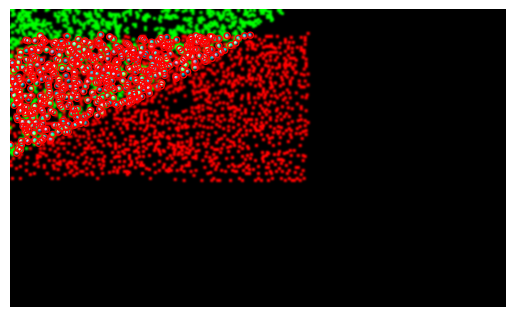

Working on: Pos00093

[ 10.81 -17.16]
Matched clusters before transform update:  706
Matched clusters after transform update:  745
Out of  1655  smFRET peaks and  5503  clusters
Percentage of matched smFRET peaks:  45
Percentage of matched clusters:  13


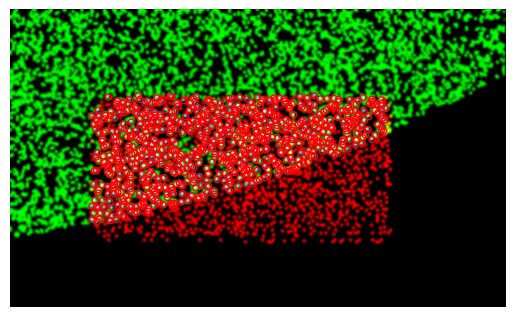

Working on: Pos00094

[  9.   -18.67]
Matched clusters before transform update:  1148
Matched clusters after transform update:  1197
Out of  1692  smFRET peaks and  7566  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  15


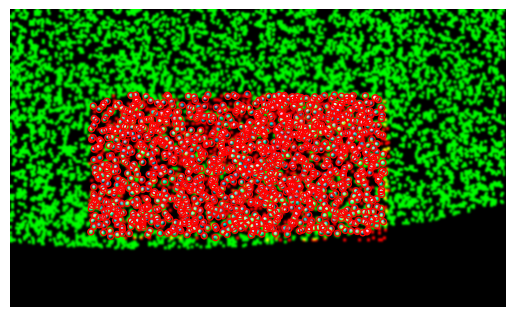

Working on: Pos00095

[  8.46 -19.71]
Matched clusters before transform update:  1092
Matched clusters after transform update:  1139
Out of  1658  smFRET peaks and  7359  clusters
Percentage of matched smFRET peaks:  68
Percentage of matched clusters:  15


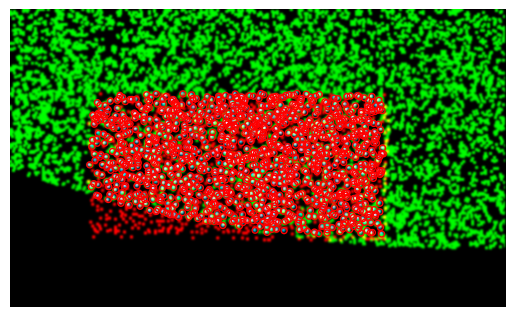

Working on: Pos00096

[-60.97 203.01]
Matched clusters before transform update:  584
Matched clusters after transform update:  758
Out of  1662  smFRET peaks and  4500  clusters
Percentage of matched smFRET peaks:  45
Percentage of matched clusters:  16


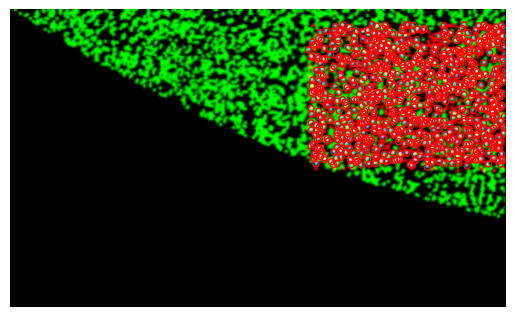

Working on: Pos00097

[-113.12  201.87]
Matched clusters before transform update:  221
Matched clusters after transform update:  280
Out of  1649  smFRET peaks and  695  clusters
Percentage of matched smFRET peaks:  16
Percentage of matched clusters:  40


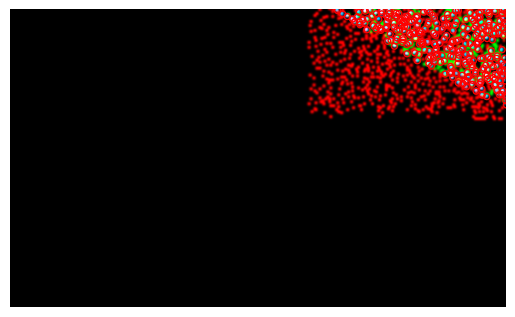

Working on: Pos00098

Working on: Pos00121

[-126.91 -139.88]
Not enough smFRET peaks (<4)
Working on: Pos00122

[ 19.1  117.13]
Matched clusters before transform update:  643
Matched clusters after transform update:  793
Out of  1642  smFRET peaks and  4299  clusters
Percentage of matched smFRET peaks:  48
Percentage of matched clusters:  18


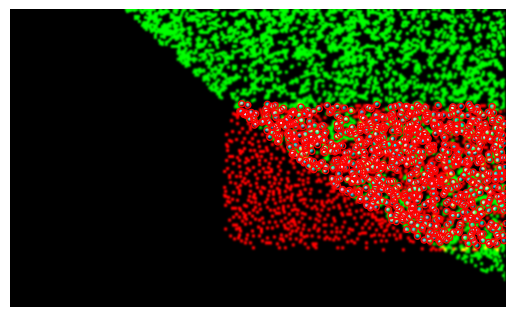

Working on: Pos00123

[  6.83 -23.58]
Matched clusters before transform update:  1176
Matched clusters after transform update:  1226
Out of  1674  smFRET peaks and  9639  clusters
Percentage of matched smFRET peaks:  73
Percentage of matched clusters:  12


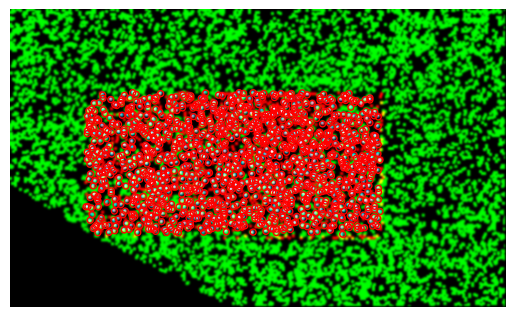

Working on: Pos00124

[  6.81 -22.44]
Matched clusters before transform update:  1167
Matched clusters after transform update:  1216
Out of  1722  smFRET peaks and  10079  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  12


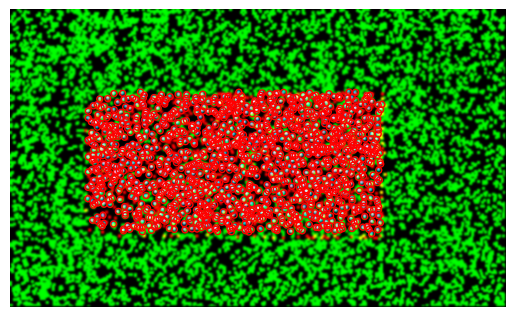

Working on: Pos00125

[  7.74 -21.55]
Matched clusters before transform update:  1118
Matched clusters after transform update:  1160
Out of  1671  smFRET peaks and  9695  clusters
Percentage of matched smFRET peaks:  69
Percentage of matched clusters:  11


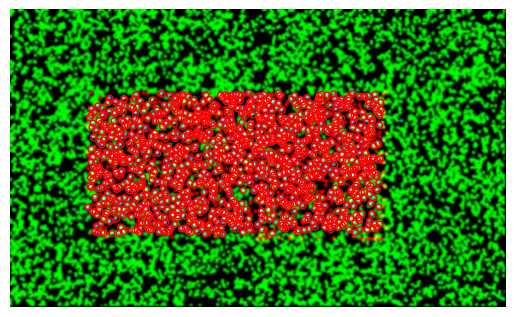

Working on: Pos00126

[  9.87 -19.45]
Matched clusters before transform update:  1232
Matched clusters after transform update:  1265
Out of  1743  smFRET peaks and  9666  clusters
Percentage of matched smFRET peaks:  72
Percentage of matched clusters:  13


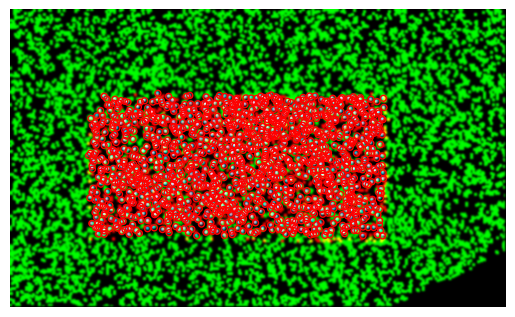

Working on: Pos00127

[ 11.65 -17.16]
Matched clusters before transform update:  860
Matched clusters after transform update:  918
Out of  1708  smFRET peaks and  6151  clusters
Percentage of matched smFRET peaks:  53
Percentage of matched clusters:  14


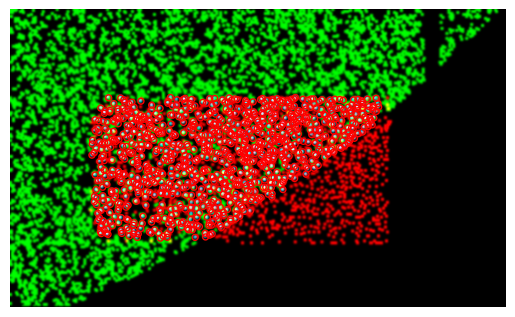

Working on: Pos00128

[-122.04  195.2 ]
Not enough smFRET peaks (<4)
Working on: Pos00135

[ 11.94 -12.34]
Matched clusters before transform update:  345
Matched clusters after transform update:  371
Out of  1656  smFRET peaks and  3973  clusters
Percentage of matched smFRET peaks:  22
Percentage of matched clusters:  9


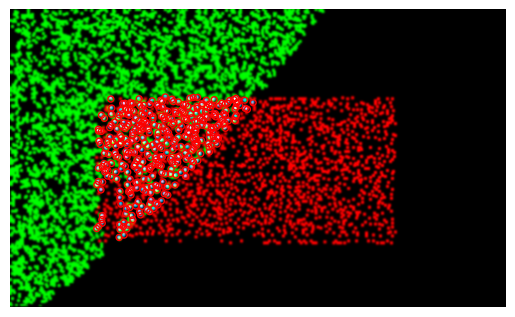

Working on: Pos00136

[  9.87 -14.46]
Matched clusters before transform update:  1230
Matched clusters after transform update:  1246
Out of  1736  smFRET peaks and  9545  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  13


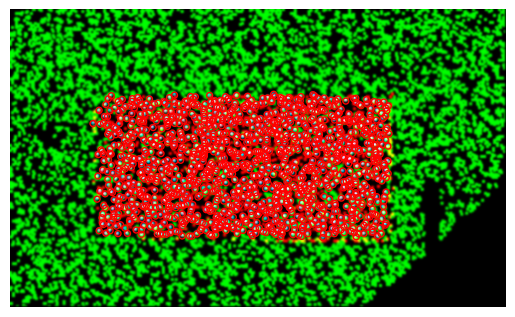

Working on: Pos00137

[  8.31 -15.28]
Matched clusters before transform update:  1144
Matched clusters after transform update:  1183
Out of  1689  smFRET peaks and  9739  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  12


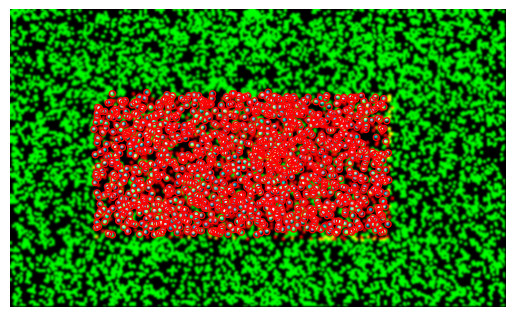

Working on: Pos00138

[  6.23 -16.2 ]
Matched clusters before transform update:  1111
Matched clusters after transform update:  1178
Out of  1668  smFRET peaks and  9442  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  12


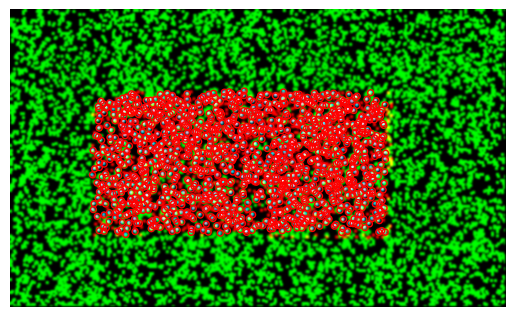

Working on: Pos00139

[  5.75 -16.79]
Matched clusters before transform update:  1191
Matched clusters after transform update:  1233
Out of  1683  smFRET peaks and  9894  clusters
Percentage of matched smFRET peaks:  73
Percentage of matched clusters:  12


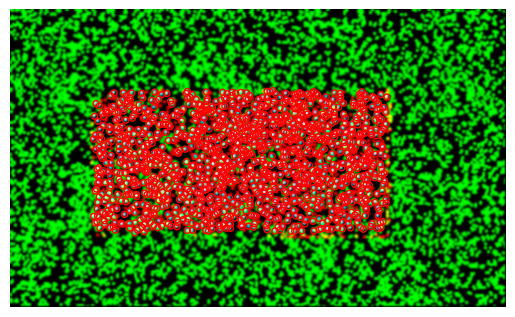

Working on: Pos00140

[  4.36 -18.05]
Matched clusters before transform update:  1149
Matched clusters after transform update:  1203
Out of  1710  smFRET peaks and  10091  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  11


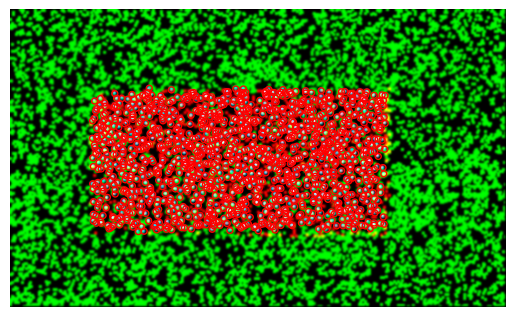

Working on: Pos00141

[  4.33 -21.44]
Matched clusters before transform update:  1097
Matched clusters after transform update:  1156
Out of  1688  smFRET peaks and  8442  clusters
Percentage of matched smFRET peaks:  68
Percentage of matched clusters:  13


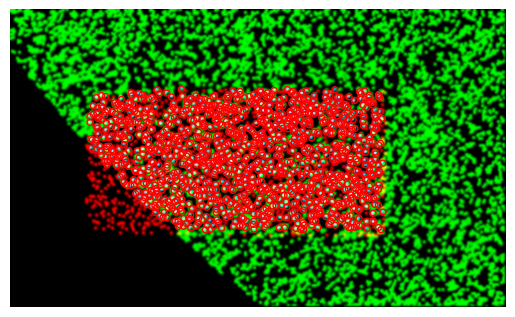

Working on: Pos00142

[-82.99 163.97]
Matched clusters before transform update:  517
Matched clusters after transform update:  640
Out of  1678  smFRET peaks and  1990  clusters
Percentage of matched smFRET peaks:  38
Percentage of matched clusters:  32


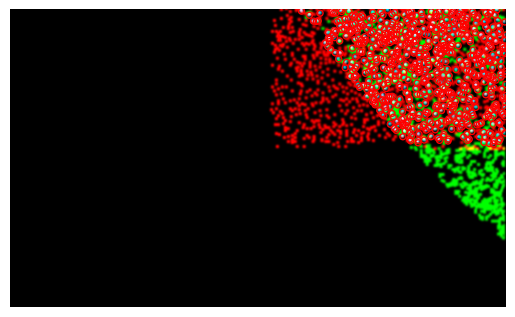

Working on: Pos00165

[ -4.07 162.82]
Matched clusters before transform update:  673
Matched clusters after transform update:  894
Out of  1724  smFRET peaks and  4889  clusters
Percentage of matched smFRET peaks:  51
Percentage of matched clusters:  18


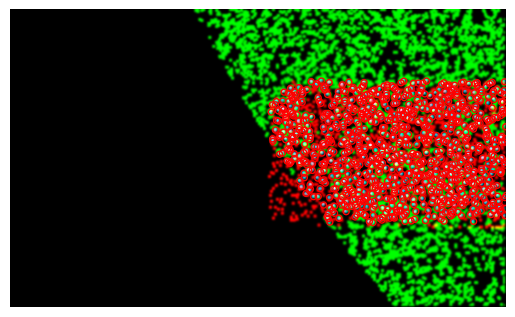

Working on: Pos00166

[  4.49 -22.66]
Matched clusters before transform update:  1192
Matched clusters after transform update:  1235
Out of  1668  smFRET peaks and  10325  clusters
Percentage of matched smFRET peaks:  74
Percentage of matched clusters:  11


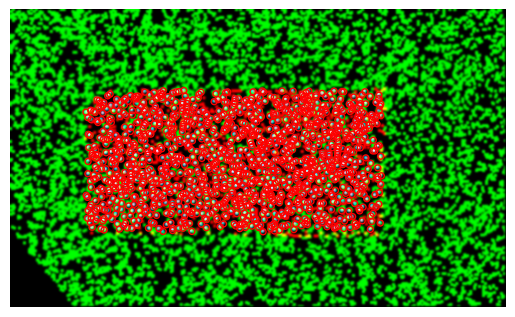

Working on: Pos00167

[  4.26 -20.68]
Matched clusters before transform update:  1136
Matched clusters after transform update:  1165
Out of  1632  smFRET peaks and  9643  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  12


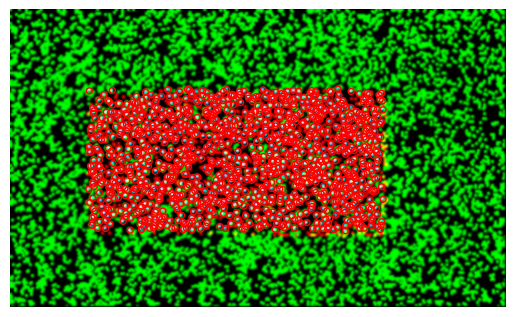

Working on: Pos00168

[  5.   -19.19]
Matched clusters before transform update:  1147
Matched clusters after transform update:  1193
Out of  1642  smFRET peaks and  9642  clusters
Percentage of matched smFRET peaks:  72
Percentage of matched clusters:  12


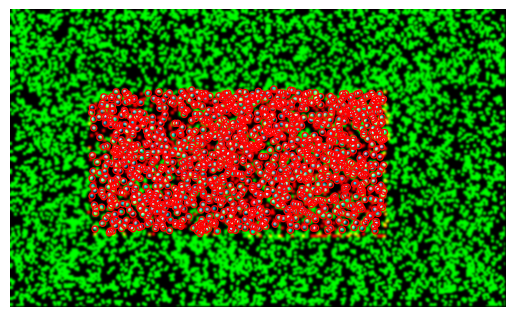

Working on: Pos00169

[  6.19 -19.03]
Matched clusters before transform update:  1165
Matched clusters after transform update:  1203
Out of  1685  smFRET peaks and  9670  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  12


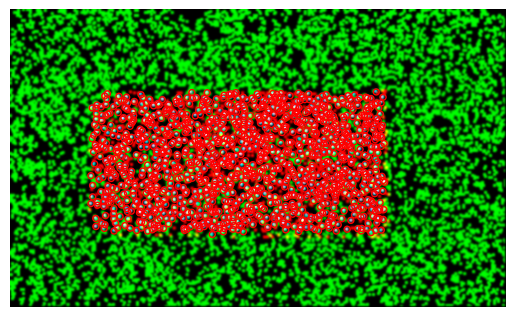

Working on: Pos00170

[  8.63 -18.2 ]
Matched clusters before transform update:  1205
Matched clusters after transform update:  1253
Out of  1730  smFRET peaks and  9932  clusters
Percentage of matched smFRET peaks:  72
Percentage of matched clusters:  12


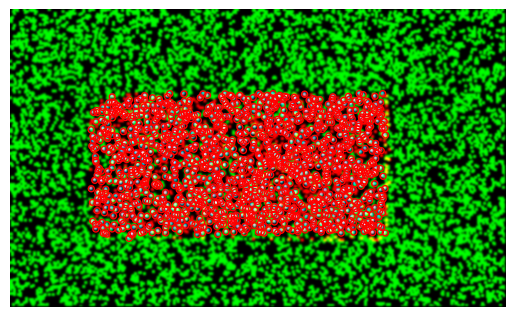

Working on: Pos00171

[ 10.13 -17.53]
Matched clusters before transform update:  1176
Matched clusters after transform update:  1215
Out of  1733  smFRET peaks and  10202  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  11


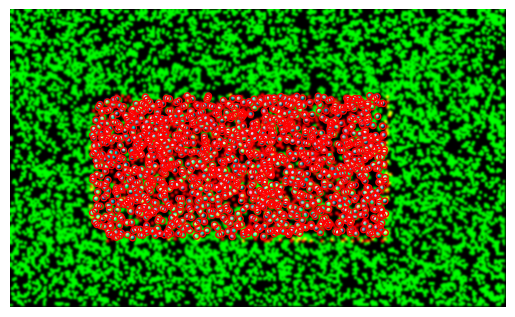

Working on: Pos00172

[ 12.71 -15.41]
Matched clusters before transform update:  1026
Matched clusters after transform update:  1082
Out of  1740  smFRET peaks and  7133  clusters
Percentage of matched smFRET peaks:  62
Percentage of matched clusters:  15


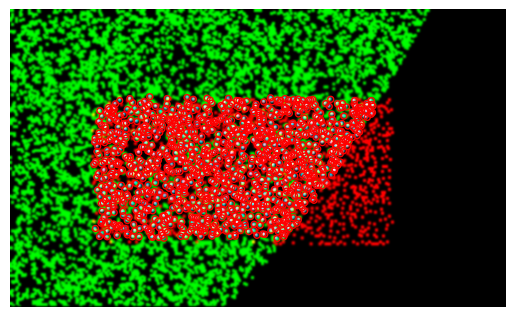

Working on: Pos00179

[ 10.75 -11.95]
Matched clusters before transform update:  1187
Matched clusters after transform update:  1245
Out of  1686  smFRET peaks and  8630  clusters
Percentage of matched smFRET peaks:  73
Percentage of matched clusters:  14


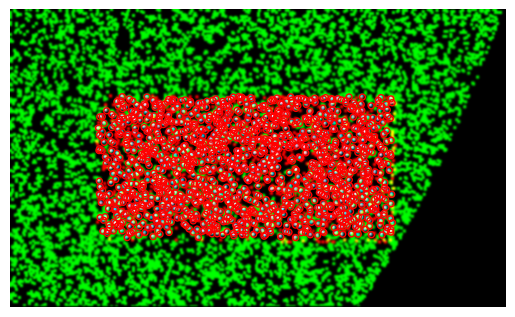

Working on: Pos00180

[  8.12 -13.38]
Matched clusters before transform update:  1136
Matched clusters after transform update:  1146
Out of  1635  smFRET peaks and  9814  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  11


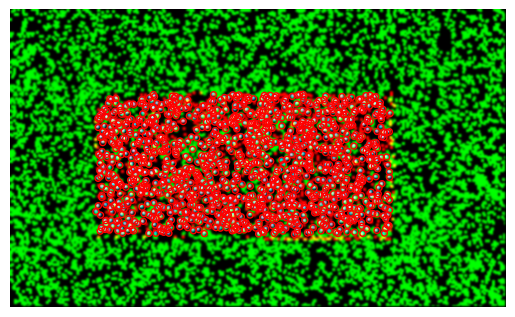

Working on: Pos00181

[  6.29 -14.45]
Matched clusters before transform update:  1182
Matched clusters after transform update:  1229
Out of  1698  smFRET peaks and  9706  clusters
Percentage of matched smFRET peaks:  72
Percentage of matched clusters:  12


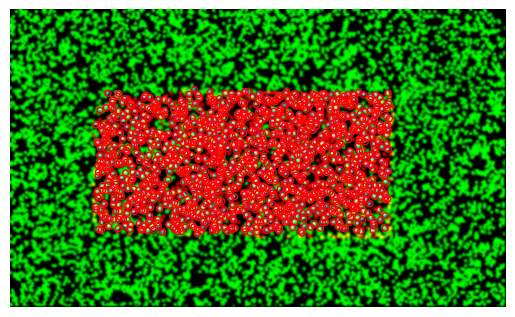

Working on: Pos00182

[  5.03 -15.22]
Matched clusters before transform update:  1142
Matched clusters after transform update:  1185
Out of  1676  smFRET peaks and  9884  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  11


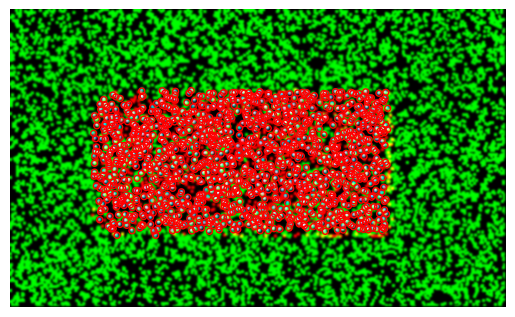

Working on: Pos00183

[  3.48 -15.52]
Matched clusters before transform update:  1163
Matched clusters after transform update:  1225
Out of  1663  smFRET peaks and  9683  clusters
Percentage of matched smFRET peaks:  73
Percentage of matched clusters:  12


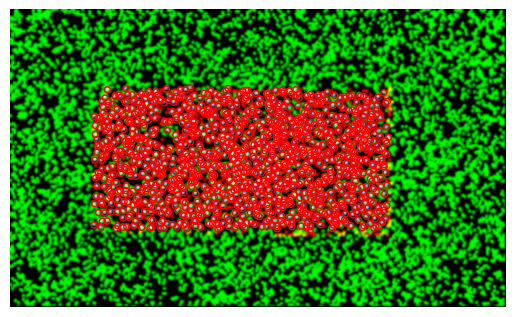

Working on: Pos00184

[  2.47 -16.24]
Matched clusters before transform update:  1225
Matched clusters after transform update:  1269
Out of  1766  smFRET peaks and  9589  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  13


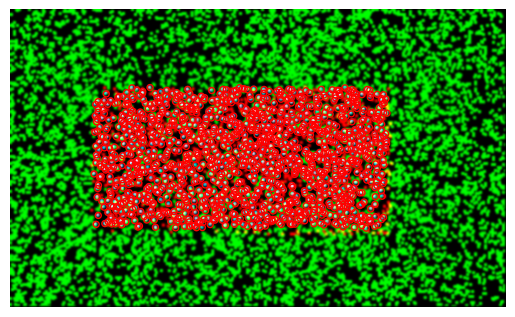

Working on: Pos00185

[  1.79 -17.37]
Matched clusters before transform update:  1133
Matched clusters after transform update:  1206
Out of  1587  smFRET peaks and  10219  clusters
Percentage of matched smFRET peaks:  75
Percentage of matched clusters:  11


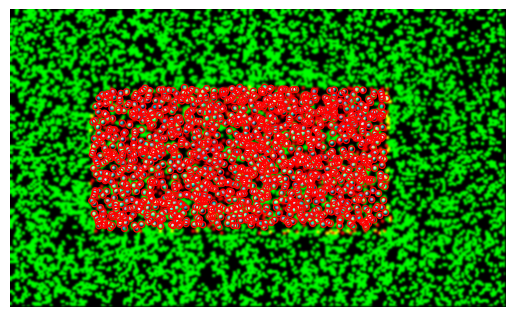

Working on: Pos00186

[  0.7  -21.04]
Matched clusters before transform update:  853
Matched clusters after transform update:  886
Out of  1677  smFRET peaks and  7119  clusters
Percentage of matched smFRET peaks:  52
Percentage of matched clusters:  12


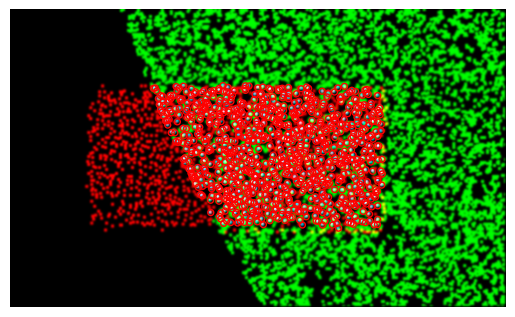

Working on: Pos00209

[ -0.37 -22.99]
Matched clusters before transform update:  1170
Matched clusters after transform update:  1196
Out of  1704  smFRET peaks and  8460  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  14


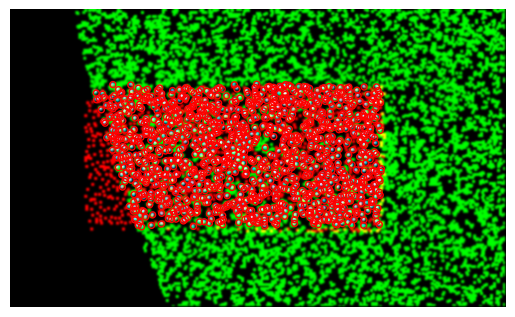

Working on: Pos00210

[  0.58 -20.27]
Matched clusters before transform update:  1170
Matched clusters after transform update:  1203
Out of  1668  smFRET peaks and  10148  clusters
Percentage of matched smFRET peaks:  72
Percentage of matched clusters:  11


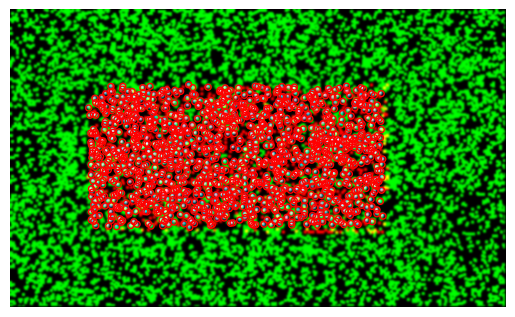

Working on: Pos00211

[  1.43 -18.35]
Matched clusters before transform update:  1211
Matched clusters after transform update:  1238
Out of  1693  smFRET peaks and  9950  clusters
Percentage of matched smFRET peaks:  73
Percentage of matched clusters:  12


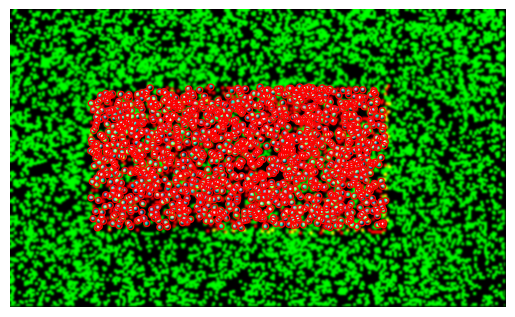

Working on: Pos00212

[  2.87 -17.94]
Matched clusters before transform update:  1115
Matched clusters after transform update:  1156
Out of  1627  smFRET peaks and  9455  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  12


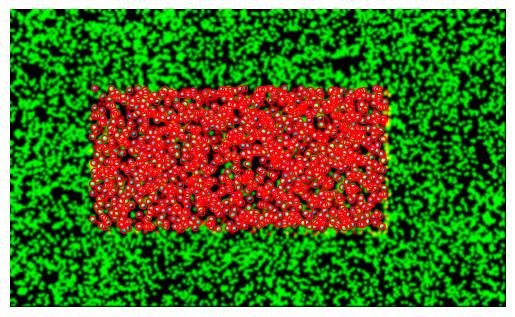

Working on: Pos00213

[  4.33 -17.83]
Matched clusters before transform update:  1147
Matched clusters after transform update:  1197
Out of  1676  smFRET peaks and  9495  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  12


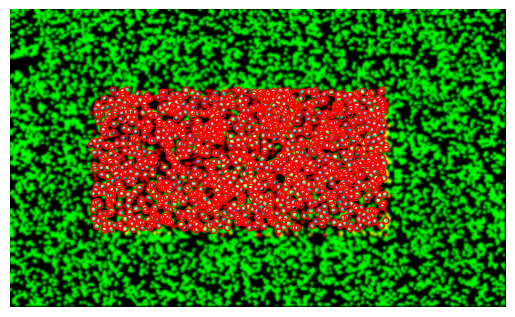

Working on: Pos00214

[  5.39 -17.03]
Matched clusters before transform update:  1183
Matched clusters after transform update:  1214
Out of  1675  smFRET peaks and  9455  clusters
Percentage of matched smFRET peaks:  72
Percentage of matched clusters:  12


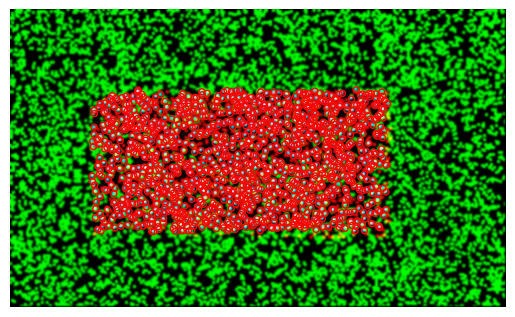

Working on: Pos00215

[  7.68 -15.53]
Matched clusters before transform update:  1180
Matched clusters after transform update:  1225
Out of  1730  smFRET peaks and  9809  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  12


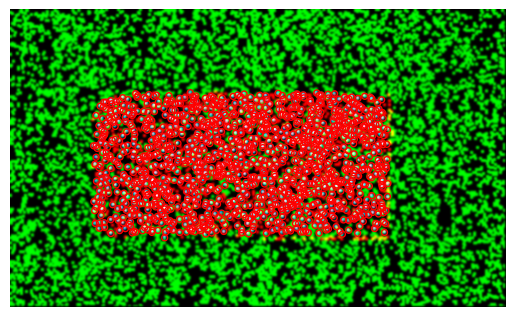

Working on: Pos00216

[  9.4  -14.83]
Matched clusters before transform update:  1205
Matched clusters after transform update:  1249
Out of  1740  smFRET peaks and  9635  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  12


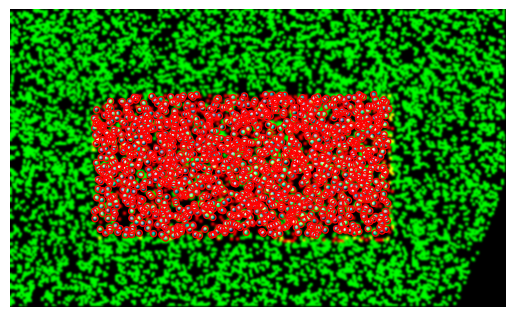

Working on: Pos00223

[  8.17 -10.44]
Matched clusters before transform update:  1183
Matched clusters after transform update:  1245
Out of  1740  smFRET peaks and  10243  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  12


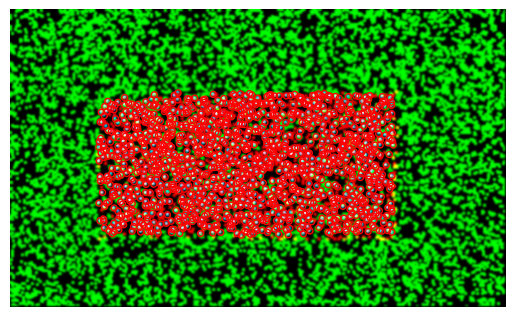

Working on: Pos00224

[  6.81 -12.57]
Matched clusters before transform update:  1220
Matched clusters after transform update:  1271
Out of  1737  smFRET peaks and  10151  clusters
Percentage of matched smFRET peaks:  73
Percentage of matched clusters:  12


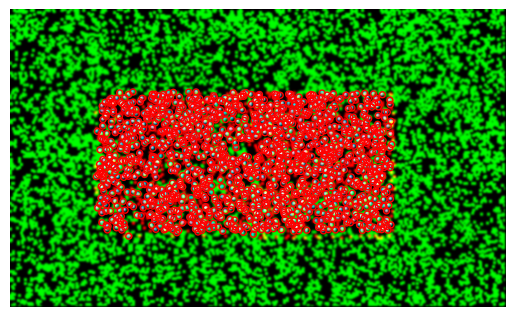

Working on: Pos00225

[  5.   -13.22]
Matched clusters before transform update:  1177
Matched clusters after transform update:  1243
Out of  1730  smFRET peaks and  9717  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  12


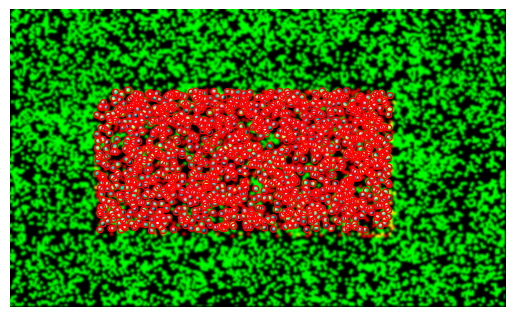

Working on: Pos00226

[  3.45 -14.23]
Matched clusters before transform update:  1228
Matched clusters after transform update:  1268
Out of  1775  smFRET peaks and  9562  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  13


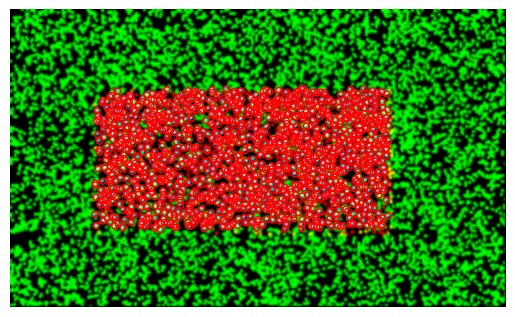

Working on: Pos00227

[  2.55 -13.24]
Matched clusters before transform update:  1225
Matched clusters after transform update:  1256
Out of  1783  smFRET peaks and  9782  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  12


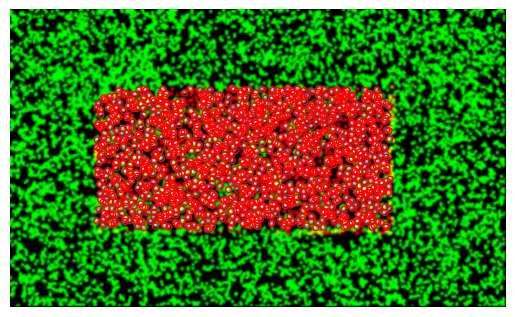

Working on: Pos00228

[  0.62 -14.6 ]
Matched clusters before transform update:  1230
Matched clusters after transform update:  1288
Out of  1760  smFRET peaks and  10222  clusters
Percentage of matched smFRET peaks:  73
Percentage of matched clusters:  12


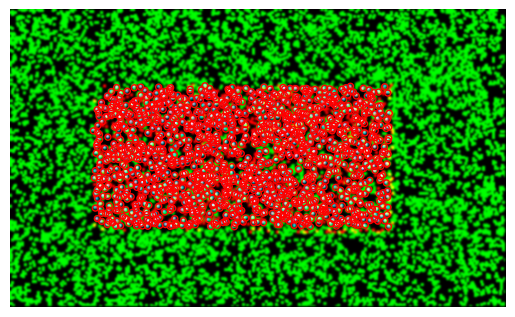

Working on: Pos00229

[ -0.41 -15.37]
Matched clusters before transform update:  1284
Matched clusters after transform update:  1341
Out of  1836  smFRET peaks and  10353  clusters
Percentage of matched smFRET peaks:  73
Percentage of matched clusters:  12


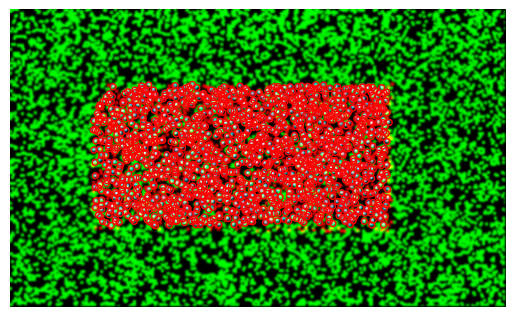

Working on: Pos00230

[ -1.45 -19.39]
Matched clusters before transform update:  1126
Matched clusters after transform update:  1172
Out of  1602  smFRET peaks and  9174  clusters
Percentage of matched smFRET peaks:  73
Percentage of matched clusters:  12


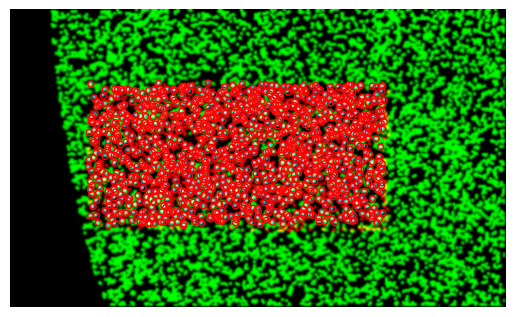

Working on: Pos00253

[ -2.21 -20.88]
Matched clusters before transform update:  1204
Matched clusters after transform update:  1259
Out of  1732  smFRET peaks and  9651  clusters
Percentage of matched smFRET peaks:  72
Percentage of matched clusters:  13


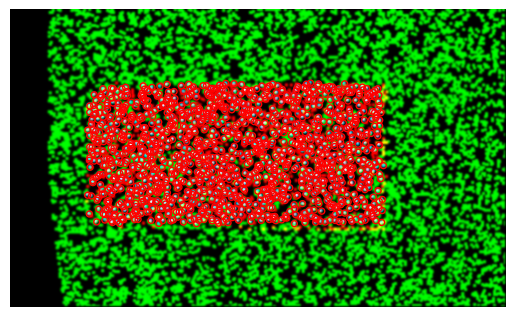

Working on: Pos00254

[ -0.52 -17.74]
Matched clusters before transform update:  1279
Matched clusters after transform update:  1315
Out of  1751  smFRET peaks and  10418  clusters
Percentage of matched smFRET peaks:  75
Percentage of matched clusters:  12


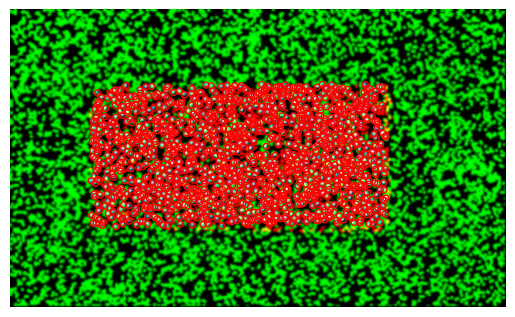

Working on: Pos00255

[  0.8  -16.74]
Matched clusters before transform update:  1220
Matched clusters after transform update:  1250
Out of  1765  smFRET peaks and  10172  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  12


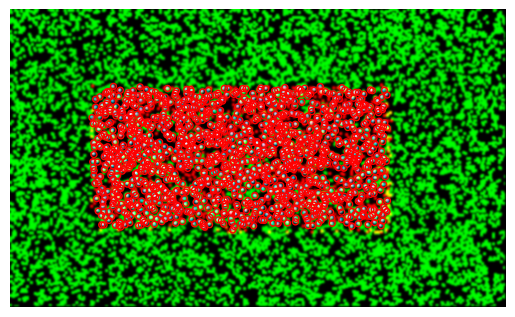

Working on: Pos00256

[  2.73 -16.11]
Matched clusters before transform update:  1206
Matched clusters after transform update:  1252
Out of  1712  smFRET peaks and  9915  clusters
Percentage of matched smFRET peaks:  73
Percentage of matched clusters:  12


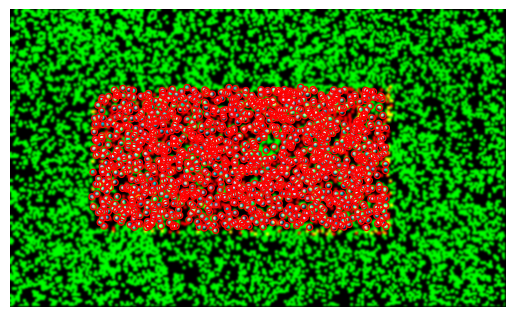

Working on: Pos00257

[  3.69 -16.11]
Matched clusters before transform update:  1211
Matched clusters after transform update:  1249
Out of  1740  smFRET peaks and  9458  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  13


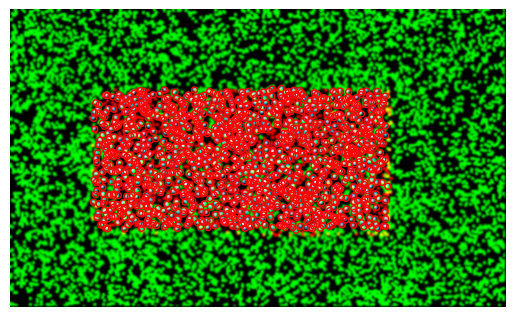

Working on: Pos00258

[  4.52 -15.58]
Matched clusters before transform update:  1256
Matched clusters after transform update:  1308
Out of  1774  smFRET peaks and  9443  clusters
Percentage of matched smFRET peaks:  73
Percentage of matched clusters:  13


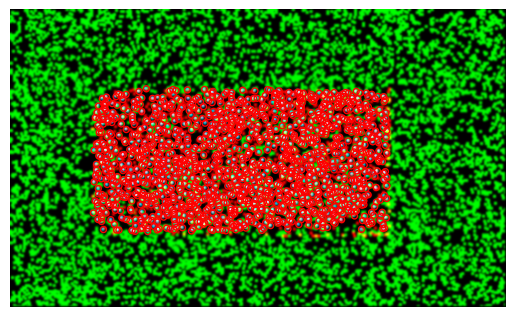

Working on: Pos00259

[  6.72 -14.9 ]
Matched clusters before transform update:  1206
Matched clusters after transform update:  1252
Out of  1786  smFRET peaks and  9668  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  12


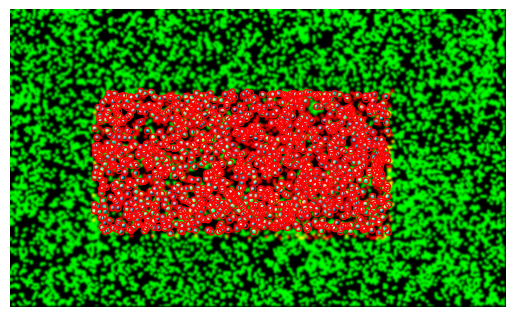

Working on: Pos00260

[  7.84 -13.54]
Matched clusters before transform update:  1306
Matched clusters after transform update:  1319
Out of  1802  smFRET peaks and  10461  clusters
Percentage of matched smFRET peaks:  73
Percentage of matched clusters:  12


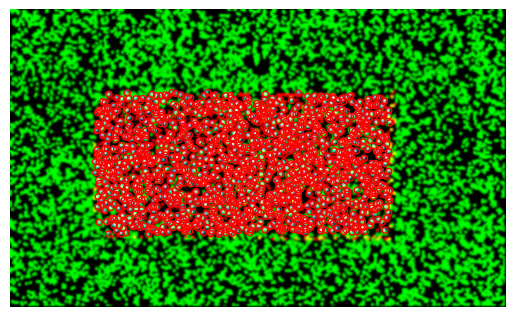

Working on: Pos00267

[ 7.28 -9.25]
Matched clusters before transform update:  1233
Matched clusters after transform update:  1273
Out of  1737  smFRET peaks and  9984  clusters
Percentage of matched smFRET peaks:  73
Percentage of matched clusters:  12


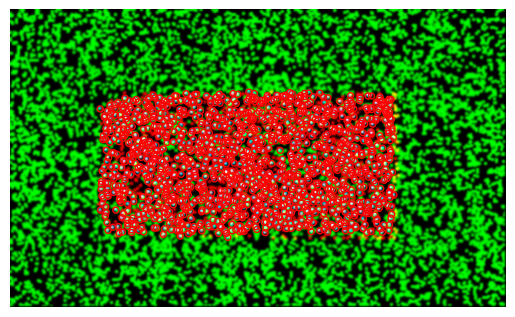

Working on: Pos00268

[  5.4  -10.54]
Matched clusters before transform update:  1195
Matched clusters after transform update:  1234
Out of  1772  smFRET peaks and  9669  clusters
Percentage of matched smFRET peaks:  69
Percentage of matched clusters:  12


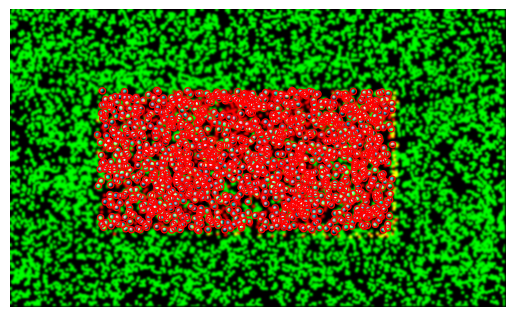

Working on: Pos00269

[  3.49 -11.48]
Matched clusters before transform update:  1160
Matched clusters after transform update:  1196
Out of  1720  smFRET peaks and  9428  clusters
Percentage of matched smFRET peaks:  69
Percentage of matched clusters:  12


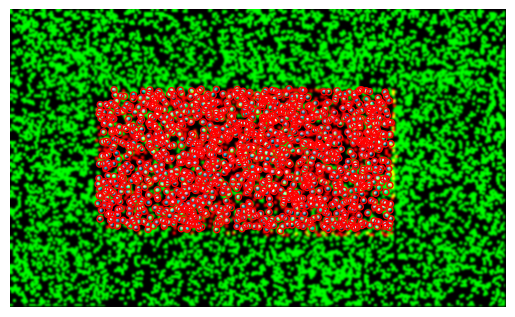

Working on: Pos00270

[  2.58 -12.75]
Matched clusters before transform update:  1138
Matched clusters after transform update:  1194
Out of  1706  smFRET peaks and  9273  clusters
Percentage of matched smFRET peaks:  69
Percentage of matched clusters:  12


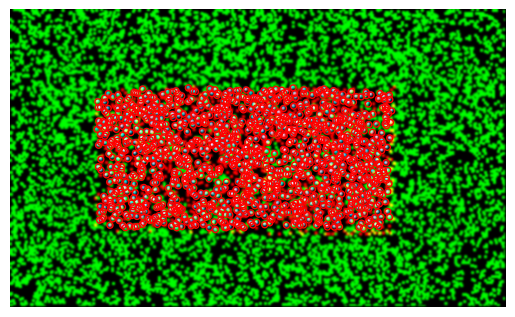

Working on: Pos00271

[  0.78 -11.72]
Matched clusters before transform update:  1204
Matched clusters after transform update:  1241
Out of  1770  smFRET peaks and  9766  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  12


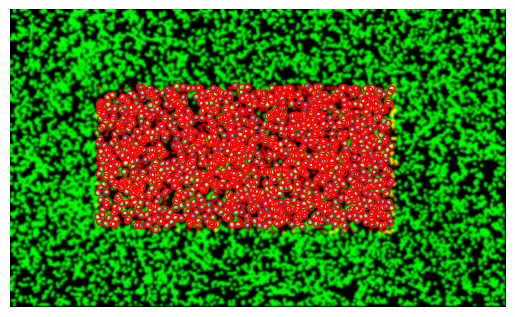

Working on: Pos00272

[ -0.65 -12.32]
Matched clusters before transform update:  1181
Matched clusters after transform update:  1207
Out of  1692  smFRET peaks and  9946  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  12


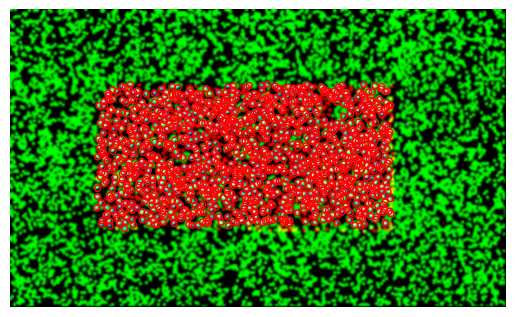

Working on: Pos00273

[ -1.91 -13.44]
Matched clusters before transform update:  1262
Matched clusters after transform update:  1300
Out of  1757  smFRET peaks and  10366  clusters
Percentage of matched smFRET peaks:  73
Percentage of matched clusters:  12


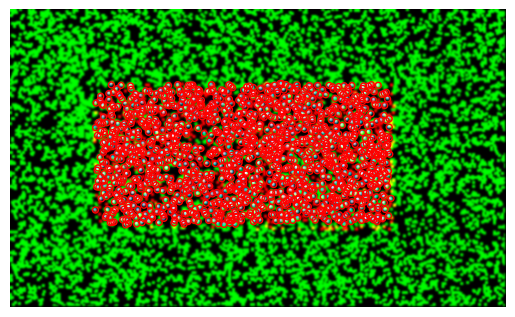

Working on: Pos00274

[ -3.51 -16.77]
Matched clusters before transform update:  1227
Matched clusters after transform update:  1276
Out of  1720  smFRET peaks and  10079  clusters
Percentage of matched smFRET peaks:  74
Percentage of matched clusters:  12


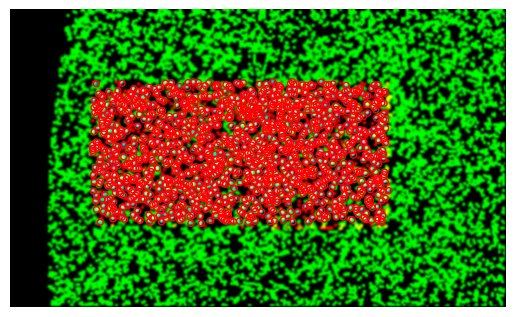

Working on: Pos00297

[ -4.44 -19.71]
Matched clusters before transform update:  1209
Matched clusters after transform update:  1246
Out of  1694  smFRET peaks and  9655  clusters
Percentage of matched smFRET peaks:  73
Percentage of matched clusters:  12


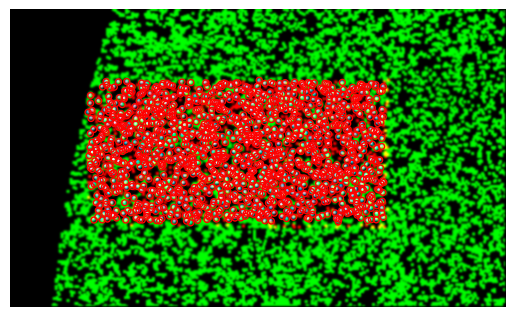

Working on: Pos00298

[ -2.91 -16.76]
Matched clusters before transform update:  1187
Matched clusters after transform update:  1211
Out of  1686  smFRET peaks and  10242  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  11


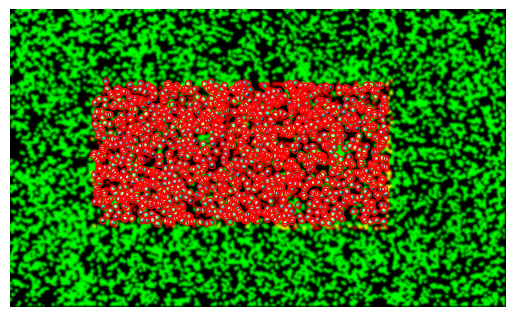

Working on: Pos00299

[ -0.59 -15.75]
Matched clusters before transform update:  1215
Matched clusters after transform update:  1258
Out of  1756  smFRET peaks and  10058  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  12


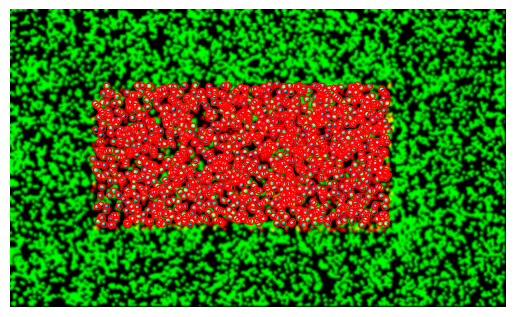

Working on: Pos00300

[  1.48 -14.93]
Matched clusters before transform update:  1214
Matched clusters after transform update:  1265
Out of  1728  smFRET peaks and  9572  clusters
Percentage of matched smFRET peaks:  73
Percentage of matched clusters:  13


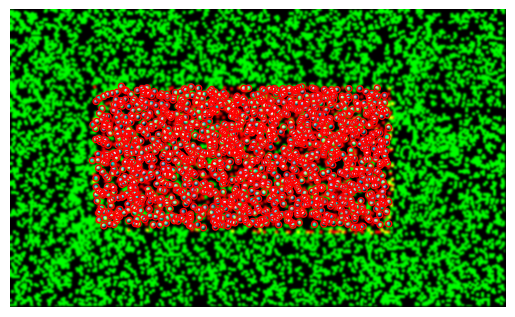

Working on: Pos00301

[  3.15 -14.36]
Matched clusters before transform update:  1174
Matched clusters after transform update:  1210
Out of  1713  smFRET peaks and  9421  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  12


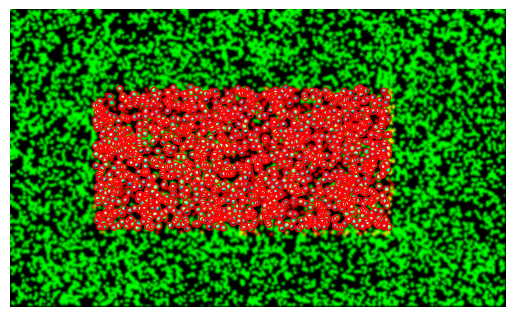

Working on: Pos00302

[  4.19 -13.9 ]
Matched clusters before transform update:  1196
Matched clusters after transform update:  1243
Out of  1727  smFRET peaks and  9607  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  12


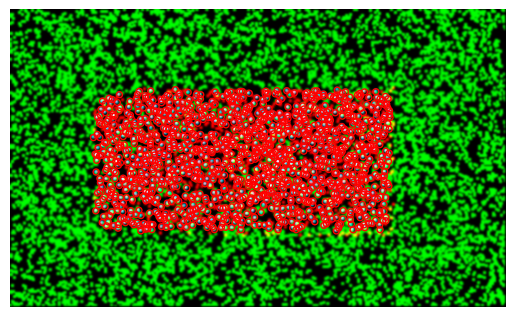

Working on: Pos00303

[  5.84 -13.21]
Matched clusters before transform update:  1220
Matched clusters after transform update:  1253
Out of  1739  smFRET peaks and  9840  clusters
Percentage of matched smFRET peaks:  72
Percentage of matched clusters:  12


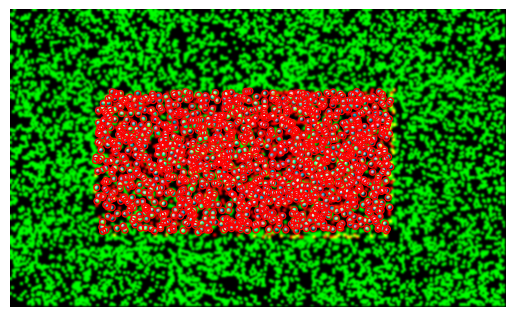

Working on: Pos00304

[  6.48 -11.63]
Matched clusters before transform update:  1215
Matched clusters after transform update:  1265
Out of  1749  smFRET peaks and  9779  clusters
Percentage of matched smFRET peaks:  72
Percentage of matched clusters:  12


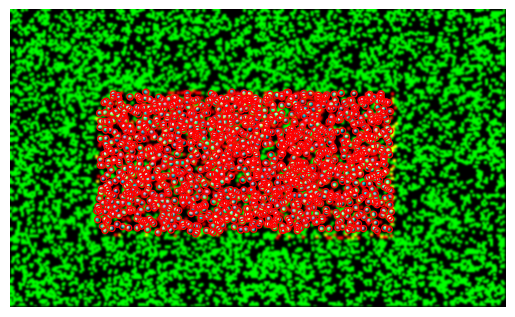

Working on: Pos00311

[ 5.79 -7.86]
Matched clusters before transform update:  1192
Matched clusters after transform update:  1236
Out of  1721  smFRET peaks and  9358  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  13


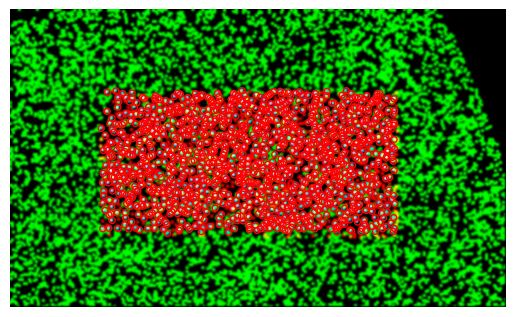

Working on: Pos00312

[ 4.77 -8.92]
Matched clusters before transform update:  1145
Matched clusters after transform update:  1200
Out of  1687  smFRET peaks and  9789  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  12


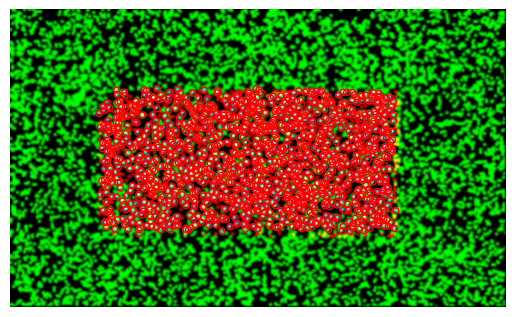

Working on: Pos00313

[ 3.48 -9.58]
Matched clusters before transform update:  1177
Matched clusters after transform update:  1212
Out of  1771  smFRET peaks and  9292  clusters
Percentage of matched smFRET peaks:  68
Percentage of matched clusters:  13


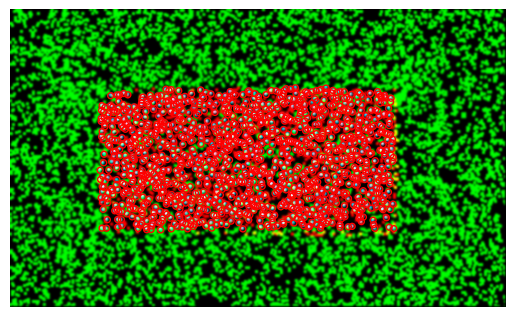

Working on: Pos00314

[  1.91 -11.03]
Matched clusters before transform update:  1105
Matched clusters after transform update:  1156
Out of  1692  smFRET peaks and  9000  clusters
Percentage of matched smFRET peaks:  68
Percentage of matched clusters:  12


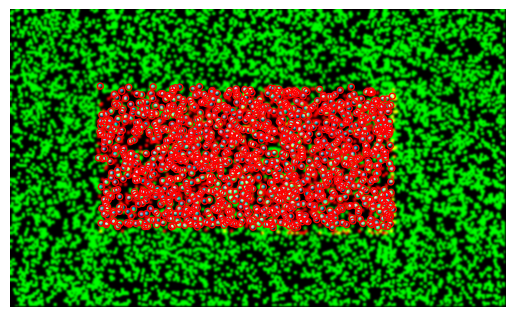

Working on: Pos00315

[  0.04 -10.16]
Matched clusters before transform update:  1242
Matched clusters after transform update:  1277
Out of  1804  smFRET peaks and  9404  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  13


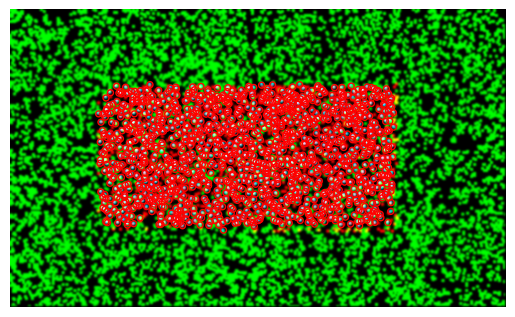

Working on: Pos00316

[ -1.47 -11.16]
Matched clusters before transform update:  1149
Matched clusters after transform update:  1180
Out of  1684  smFRET peaks and  9963  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  11


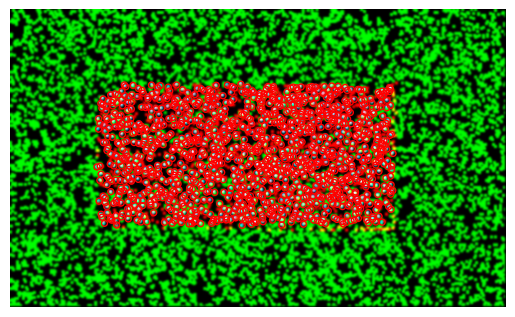

Working on: Pos00317

[ -3.24 -12.09]
Matched clusters before transform update:  1215
Matched clusters after transform update:  1241
Out of  1733  smFRET peaks and  9953  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  12


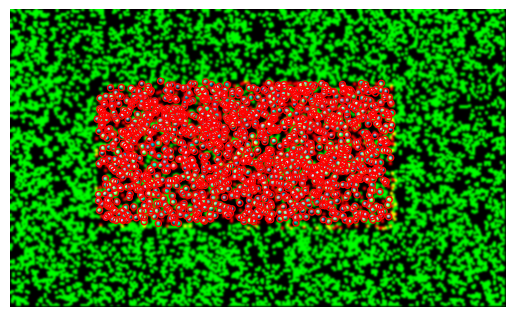

Working on: Pos00318

[ -5.56 -15.77]
Matched clusters before transform update:  1096
Matched clusters after transform update:  1124
Out of  1749  smFRET peaks and  8102  clusters
Percentage of matched smFRET peaks:  64
Percentage of matched clusters:  13


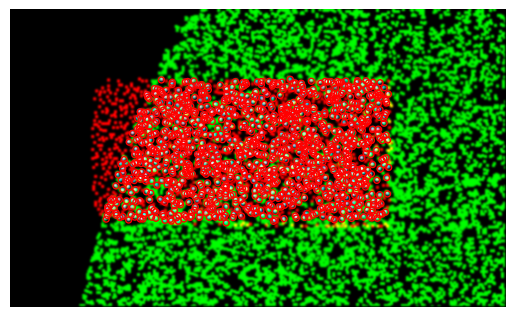

Working on: Pos00341

[ -6.4  -18.42]
Matched clusters before transform update:  790
Matched clusters after transform update:  795
Out of  1759  smFRET peaks and  6178  clusters
Percentage of matched smFRET peaks:  45
Percentage of matched clusters:  12


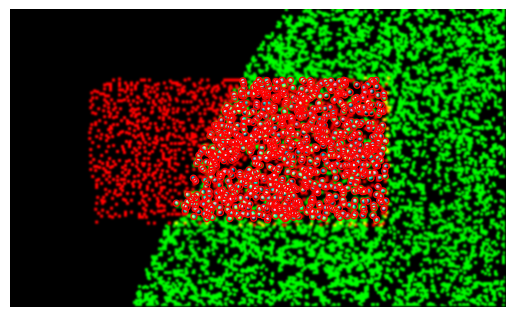

Working on: Pos00342

[ -4.22 -15.64]
Matched clusters before transform update:  1194
Matched clusters after transform update:  1227
Out of  1757  smFRET peaks and  9811  clusters
Percentage of matched smFRET peaks:  69
Percentage of matched clusters:  12


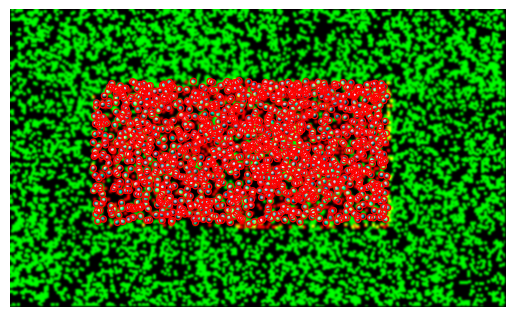

Working on: Pos00343

[ -2.24 -13.95]
Matched clusters before transform update:  1198
Matched clusters after transform update:  1240
Out of  1700  smFRET peaks and  9678  clusters
Percentage of matched smFRET peaks:  72
Percentage of matched clusters:  12


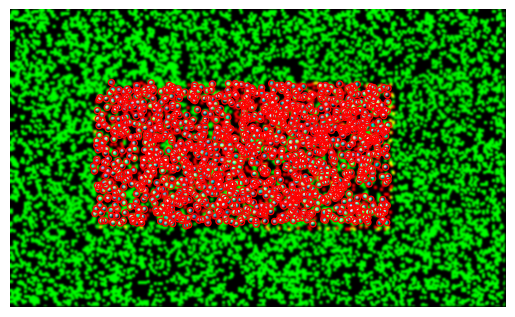

Working on: Pos00344

[ -0.59 -13.4 ]
Matched clusters before transform update:  1200
Matched clusters after transform update:  1241
Out of  1725  smFRET peaks and  9226  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  13


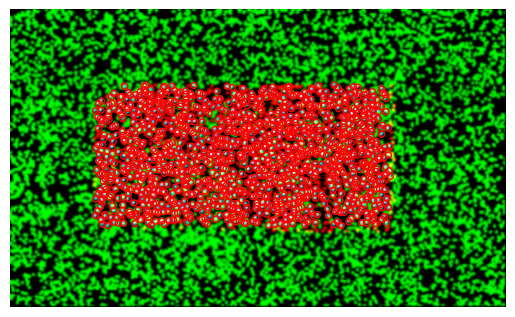

Working on: Pos00345

[  1.22 -12.56]
Matched clusters before transform update:  1162
Matched clusters after transform update:  1202
Out of  1719  smFRET peaks and  8925  clusters
Percentage of matched smFRET peaks:  69
Percentage of matched clusters:  13


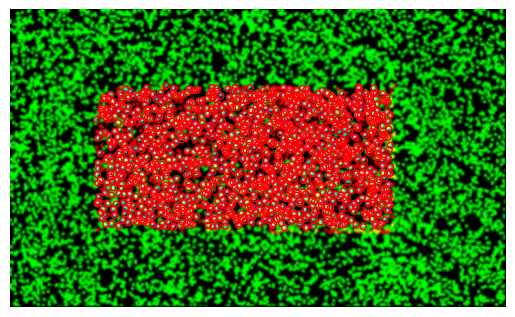

Working on: Pos00346

[  2.29 -12.18]
Matched clusters before transform update:  1142
Matched clusters after transform update:  1193
Out of  1715  smFRET peaks and  8905  clusters
Percentage of matched smFRET peaks:  69
Percentage of matched clusters:  13


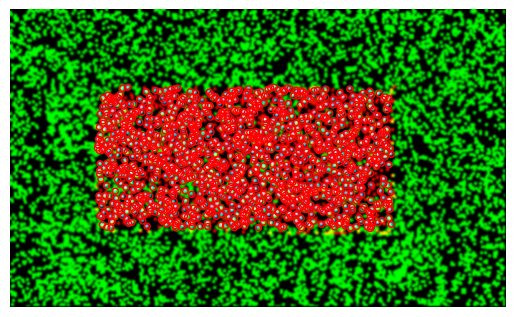

Working on: Pos00347

[  3.73 -11.57]
Matched clusters before transform update:  1169
Matched clusters after transform update:  1219
Out of  1746  smFRET peaks and  9620  clusters
Percentage of matched smFRET peaks:  69
Percentage of matched clusters:  12


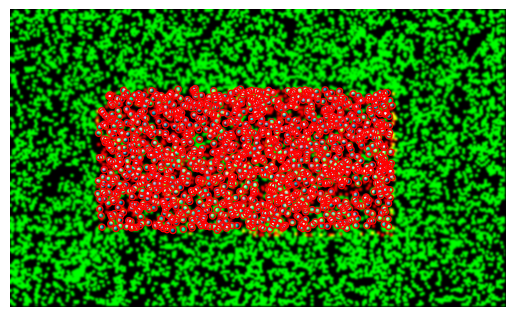

Working on: Pos00348

[ 4.61 -9.96]
Matched clusters before transform update:  1202
Matched clusters after transform update:  1234
Out of  1713  smFRET peaks and  8348  clusters
Percentage of matched smFRET peaks:  72
Percentage of matched clusters:  14


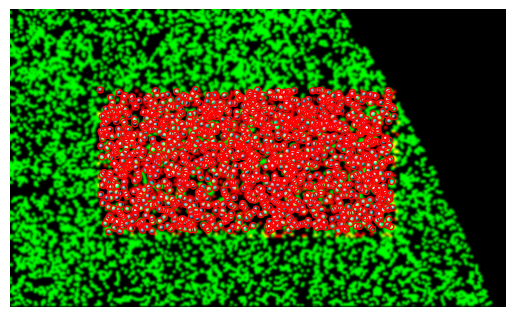

Working on: Pos00355

[ 3.42 -5.51]
Matched clusters before transform update:  900
Matched clusters after transform update:  937
Out of  1784  smFRET peaks and  6449  clusters
Percentage of matched smFRET peaks:  52
Percentage of matched clusters:  14


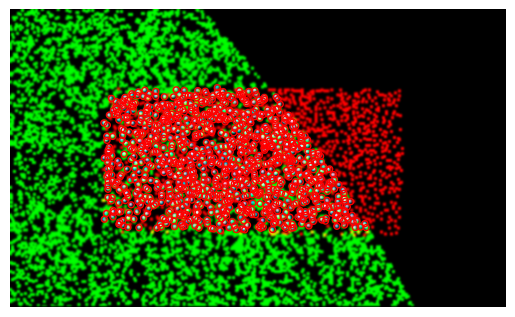

Working on: Pos00356

[ 2.25 -6.66]
Matched clusters before transform update:  1218
Matched clusters after transform update:  1238
Out of  1751  smFRET peaks and  9609  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  12


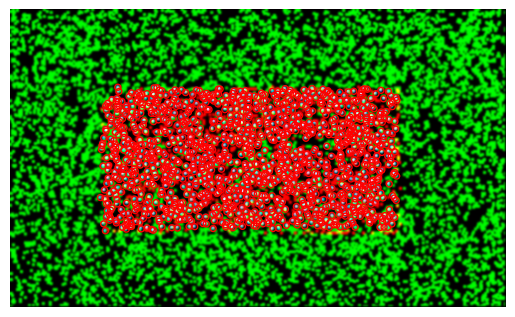

Working on: Pos00357

[ 2.04 -8.2 ]
Matched clusters before transform update:  1191
Matched clusters after transform update:  1252
Out of  1772  smFRET peaks and  9032  clusters
Percentage of matched smFRET peaks:  70
Percentage of matched clusters:  13


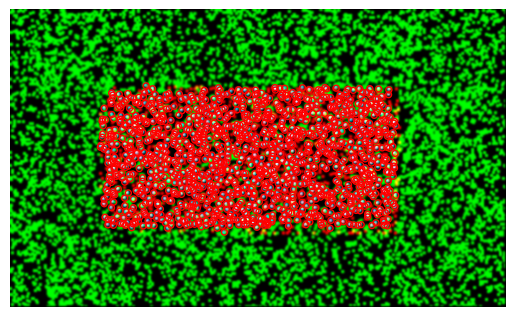

Working on: Pos00358

[ 0.62 -8.96]
Matched clusters before transform update:  1182
Matched clusters after transform update:  1230
Out of  1718  smFRET peaks and  8944  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  13


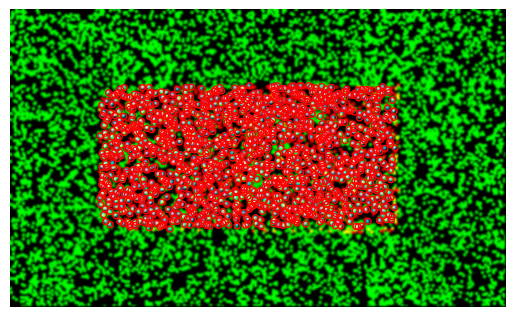

Working on: Pos00359

[-2.12 -9.05]
Matched clusters before transform update:  1189
Matched clusters after transform update:  1218
Out of  1785  smFRET peaks and  9067  clusters
Percentage of matched smFRET peaks:  68
Percentage of matched clusters:  13


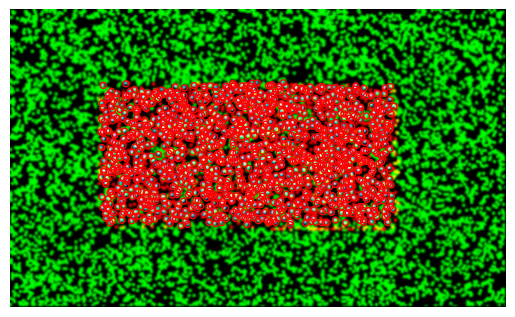

Working on: Pos00360

[ -4.01 -10.42]
Matched clusters before transform update:  1241
Matched clusters after transform update:  1275
Out of  1756  smFRET peaks and  9380  clusters
Percentage of matched smFRET peaks:  72
Percentage of matched clusters:  13


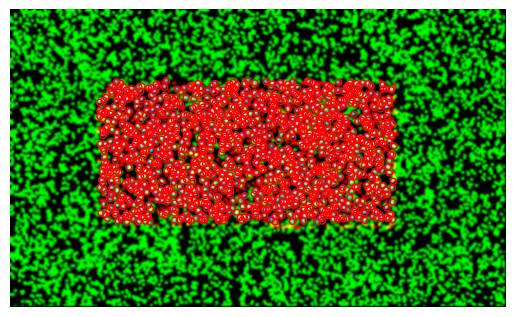

Working on: Pos00361

[ -6.29 -12.13]
Matched clusters before transform update:  1191
Matched clusters after transform update:  1231
Out of  1781  smFRET peaks and  9703  clusters
Percentage of matched smFRET peaks:  69
Percentage of matched clusters:  12


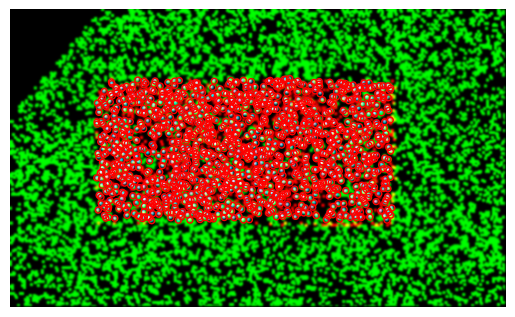

Working on: Pos00362

[ -8.24 -15.11]
Matched clusters before transform update:  342
Matched clusters after transform update:  330
Out of  1774  smFRET peaks and  4151  clusters
Percentage of matched smFRET peaks:  18
Percentage of matched clusters:  7


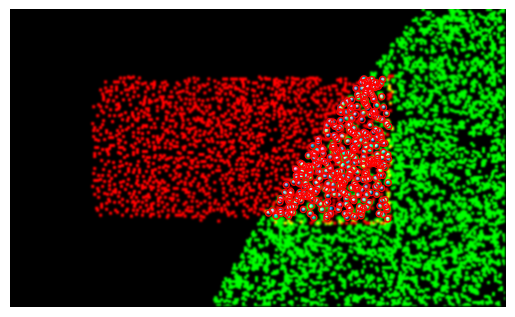

Working on: Pos00385

[ 62.09 183.81]
Matched clusters before transform update:  426
Matched clusters after transform update:  516
Out of  1836  smFRET peaks and  1421  clusters
Percentage of matched smFRET peaks:  28
Percentage of matched clusters:  36


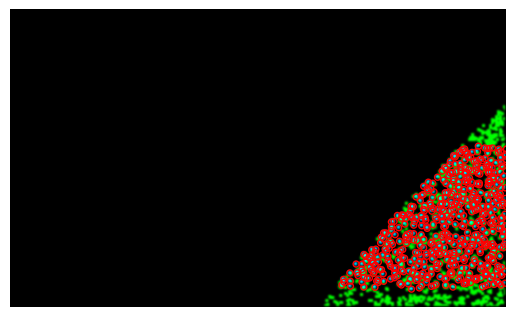

Working on: Pos00386

[ -7.08 -15.01]
Matched clusters before transform update:  1005
Matched clusters after transform update:  1049
Out of  1705  smFRET peaks and  7360  clusters
Percentage of matched smFRET peaks:  61
Percentage of matched clusters:  14


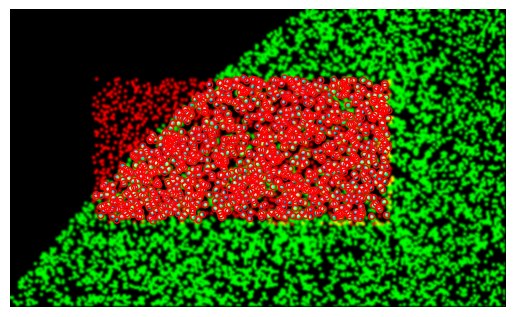

Working on: Pos00387

[ -4.32 -13.23]
Matched clusters before transform update:  1172
Matched clusters after transform update:  1208
Out of  1788  smFRET peaks and  9105  clusters
Percentage of matched smFRET peaks:  67
Percentage of matched clusters:  13


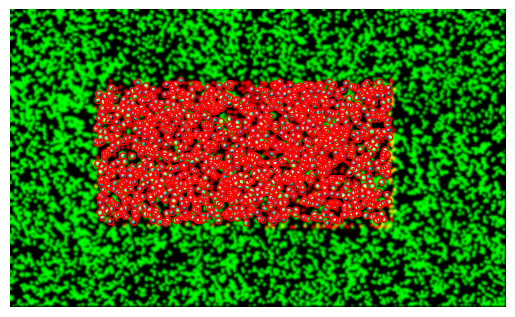

Working on: Pos00388

[ -2.2  -12.29]
Matched clusters before transform update:  1135
Matched clusters after transform update:  1172
Out of  1759  smFRET peaks and  8794  clusters
Percentage of matched smFRET peaks:  66
Percentage of matched clusters:  13


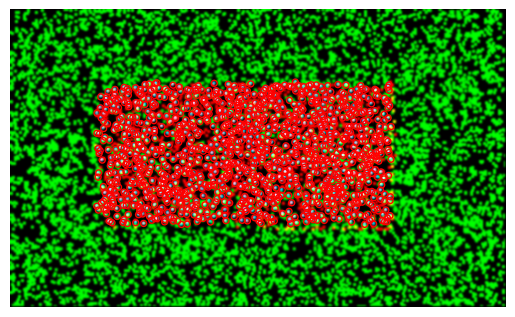

Working on: Pos00389

[ -0.12 -11.38]
Matched clusters before transform update:  1194
Matched clusters after transform update:  1242
Out of  1693  smFRET peaks and  9123  clusters
Percentage of matched smFRET peaks:  73
Percentage of matched clusters:  13


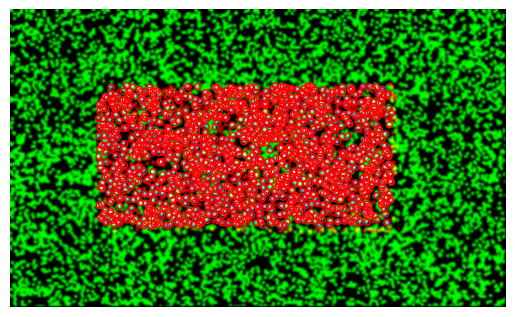

Working on: Pos00390

[  0.97 -10.38]
Matched clusters before transform update:  1185
Matched clusters after transform update:  1226
Out of  1719  smFRET peaks and  9021  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  13


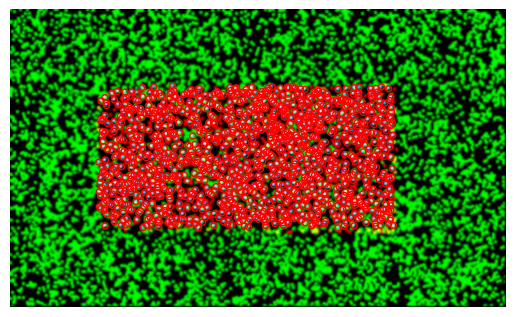

Working on: Pos00391

[ 2.1  -8.96]
Matched clusters before transform update:  1144
Matched clusters after transform update:  1178
Out of  1737  smFRET peaks and  8408  clusters
Percentage of matched smFRET peaks:  67
Percentage of matched clusters:  14


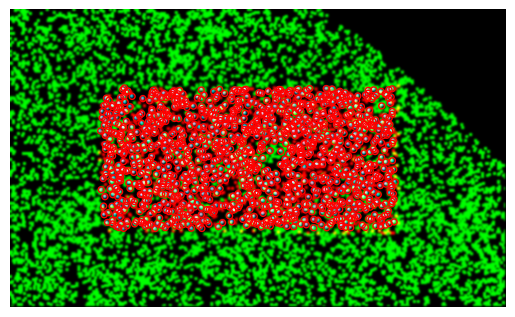

Working on: Pos00392

[  72.05 -137.02]
Matched clusters before transform update:  742
Matched clusters after transform update:  951
Out of  1755  smFRET peaks and  3179  clusters
Percentage of matched smFRET peaks:  54
Percentage of matched clusters:  29


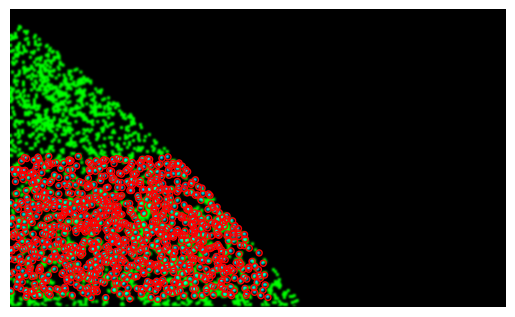

Working on: Pos00399

[ 106.16 -219.19]
Matched clusters before transform update:  215
Matched clusters after transform update:  266
Out of  1752  smFRET peaks and  556  clusters
Percentage of matched smFRET peaks:  15
Percentage of matched clusters:  47


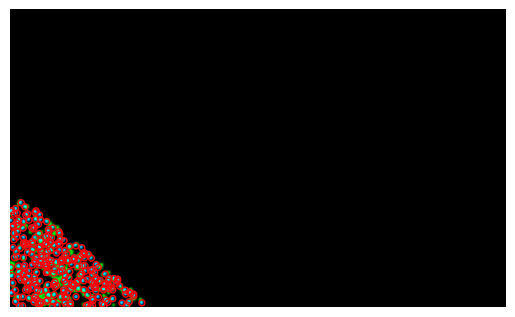

Working on: Pos00400

[-0.39 -4.11]
Matched clusters before transform update:  677
Matched clusters after transform update:  714
Out of  1727  smFRET peaks and  4696  clusters
Percentage of matched smFRET peaks:  41
Percentage of matched clusters:  15


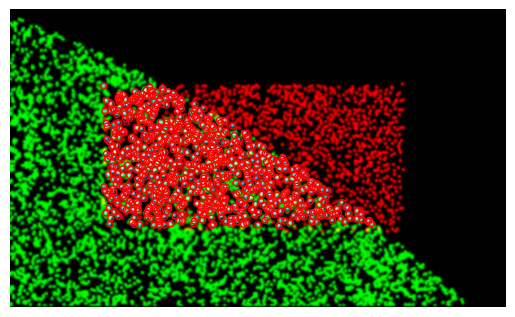

Working on: Pos00401

[-1.31 -6.11]
Matched clusters before transform update:  1145
Matched clusters after transform update:  1174
Out of  1699  smFRET peaks and  8377  clusters
Percentage of matched smFRET peaks:  69
Percentage of matched clusters:  14


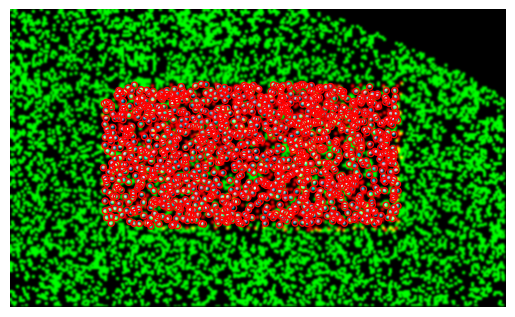

Working on: Pos00402

[-2.3  -7.77]
Matched clusters before transform update:  1209
Matched clusters after transform update:  1262
Out of  1762  smFRET peaks and  9029  clusters
Percentage of matched smFRET peaks:  71
Percentage of matched clusters:  13


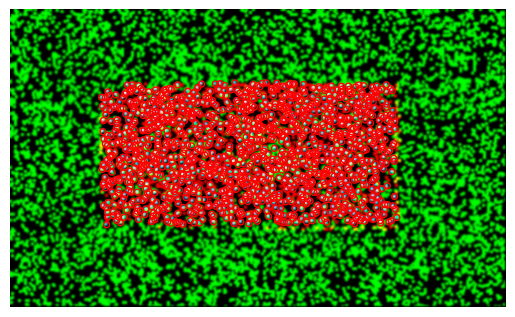

Working on: Pos00403

[-4.15 -7.7 ]
Matched clusters before transform update:  1175
Matched clusters after transform update:  1212
Out of  1762  smFRET peaks and  8699  clusters
Percentage of matched smFRET peaks:  68
Percentage of matched clusters:  13


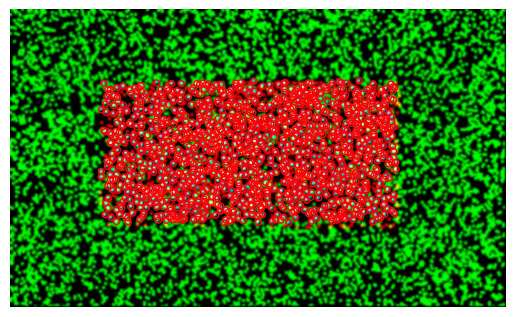

Working on: Pos00404

[-6.59 -9.69]
Matched clusters before transform update:  1157
Matched clusters after transform update:  1207
Out of  1743  smFRET peaks and  7574  clusters
Percentage of matched smFRET peaks:  69
Percentage of matched clusters:  15


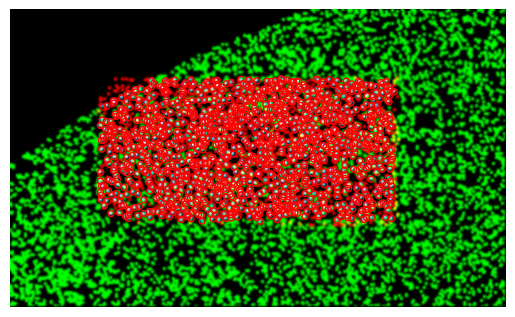

Working on: Pos00405

[76.9  82.82]
Matched clusters before transform update:  720
Matched clusters after transform update:  937
Out of  1742  smFRET peaks and  2984  clusters
Percentage of matched smFRET peaks:  53
Percentage of matched clusters:  31


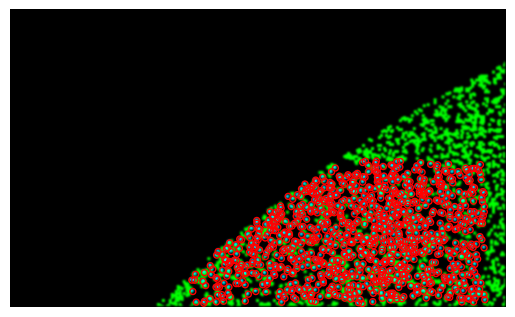

Working on: Pos00406



In [48]:
# MAIN CYCLE
os.makedirs(os.path.join(current_direct, 'QC_composites'), exist_ok=True)
os.makedirs(os.path.join(current_direct, 'QC_composites_raw'), exist_ok=True)
r = 3 # Half-width of the molecule aperture for trace extraction, i.e. for r = 3 it is -3:3
rb = 5 # Half-width of the background aperture for trace extraction 
for pos in labels_res :
#     for current_dir,dirs, files in os.walk(beads_dir) :
# #         for el in files:     
#             if el.split('.')[-2] == pos:
#     path1 = os.path.join(beads_dir,pos+'.tiff')
#     path1 = os.path.join(path_smFRET,pos,'A_Red','img_000000000.tiff')
    if os.path.exists(os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')
    else:
        continue
        
    if (not os.path.exists(os.path.join(current_direct, pos + "_traces.mat")))&(not pos in processed_pos):
#         data['sequence'] = []
        
        processed_pos.append(pos)
        pos_direct = os.path.join(current_direct, pos)
        os.makedirs(pos_direct, exist_ok=True)
        log_file = open(os.path.join(pos_direct, pos + "_log.txt"), 'w')
        log_file.write('Working on: '+ pos+'\n')
        print('Working on: '+ pos+'\n')
        FRET_coord = []
        seq_coord = []
        point = []
        counter = 0
        rb_rad = 10
#         img_beads_F = io.imread(path1) #reading the stack of images
#         if len(img_beads_F.shape) == 3:
#             if img_beads_F.shape[0] == 512: # sometimes slice number is the first dimension, sometimes the third
#                 img_beads_F = np.mean(img_beads_F, axis = 2) #averaging by the stack
#             else:
#                 img_beads_F = np.mean(img_beads_F, axis = 0) #averaging by the stack
             
#         img_beads_F = img_beads_F.astype("ushort") #turn from float format to ushort
#         img_beads_F = img_beads_F [256:512, 0:512]
#         img_beads_F = img_beads_F - rolling_ball(img_beads_F, radius=rb_rad)
#         image_array_F = transform.warp(img_beads_F, apriori_tr_inv, output_shape = [y_border, x_border])
#         image_array_F = img_as_ubyte(image_array_F)
#         #img = io.imread(current_dir + '/' + el) #initial reading of original averaging image
        #img = cv2.imread(app.st)
#         plt.figure()
#         plt.imshow(img1)
#         plt.figure()
#         plt.imshow(seq)

#         image_array_F = np.asarray(image_array_F) #array from FRET image
#         plt.figure()
#         plt.imshow(image_array_F)
        
        idx = [i for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 X_c = [posX_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 Y_c = [posY_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
        X_c = [posX_res[i] for i in idx]
        Y_c = [posY_res[i] for i in idx]

        X_c, Y_c = scaling_seq(X_c[0], Y_c[0])
#         print (X_c, Y_c)
        point.append(X_c)
        point.append(Y_c)
        point = np.array(point)
#         image_array_seq_t = image_array_seq[ Y_c:Y_c+y_border, X_c:X_c+x_border]
#         image_array_max_t = image_array_max[ Y_c:Y_c+y_border, X_c:X_c+x_border]
#         image_array_FQ_t = image_array_FQ[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        idx = [i for i,x in enumerate(x_coord) if x_coord[i] >= X_c and (x_coord[i] <= X_c+x_border) and (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+y_border)]
        x_FQ = [x_coord[i] for i in idx]
        y_FQ = [y_coord[i] for i in idx]
        seq_t = [sequence[i] for i in idx]
        seq_t_2 = [sequence_2[i] for i in idx]
        if len(seq_t)<100:
            log_file.write('Not enough (<100) clusters: '+ str(len(seq_t))+ '\n')
            continue

        #print(image_array)

        #reading by cv2 to make possible circles in color
        #img_jpg = io.imread('C:/Users/panf/Documents/Muscle_intermediates/AVG_G10_1_1_MMStack_Pos0.ome.jpg')
        #img_array = img_as_int(img)
        # displaying the image
        # setting mouse handler for the image
        # and calling the click_event() function
#         image_seq = Image.fromarray(image_array_seq_t)
#         image_seq.save (pos_direct + '/'+ pos+'_seq.tif')

#         image_fastq = Image.fromarray(image_array_FQ_t)
#         image_fastq.save (pos_direct + '/'+ pos+'_fastq.tif')

#         v_min, v_max = np.percentile(image_array_seq_t, (0, 99.8))
#         if v_max == 0: v_max = np.max(image_array_seq_t)  

#         # Calculating the shift between the FASTQ and cluster images using cross-correlation
#         shift = phase_cross_correlation(image_array_max_t,image_array_FQ_t)
#         shift = shift[0]
#         print(shift)
#         # Translation of the FASTQ sequences in the FOV to match the cluster image
        x_FQ = np.subtract(x_FQ,X_c)
        y_FQ = np.subtract(y_FQ,Y_c)
#         FQ_shifts.append([X_c-shift[1], Y_c-shift[0]])
#         FQ_shifts_pos.append(pos)
        
#         MAX_centers = blob_detection(
#             image_array_max_t,
#             min_sigma=1,
#             max_sigma=10,
#             threshold=0.0001
#         )
#         FQ_centers_all = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
#         res, idx = count_nearest_pts(FQ_centers_all, MAX_centers, 2)
#         FQ_centers_all1 = FQ_centers_all[idx[np.where(res != inf)]]
#         MAX_centers1 = MAX_centers[np.where(res != inf)]
#         print(FQ_centers_all1)
#         print(MAX_centers1)

#         trFQtoMAX = transform.estimate_transform("similarity", src=FQ_centers_all1, dst=MAX_centers1)

#         temp = trFQtoMAX(FQ_centers_all)
#         x_FQ = temp[:,0];
#         y_FQ = temp[:,1];

#         fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 0, False, 1)
        fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1)
        fastq_image1.save(os.path.join(pos_direct,pos+'_FQ.png'))
#         max_image = generate_img(MAX_centers[:,1],MAX_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
#         max_image.save(os.path.join(pos_direct,pos+'_MAX_seq_CoM.png'))
#         max_image = Image.fromarray(image_array_max_t)
#         max_image.save(os.path.join(pos_direct,pos+'_MAX_seq.png'))
#         fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1)
#         fastq_image1.save(os.path.join(pos_direct,pos+'_FQ_aligned.png'))
#         fig, ax = plt.subplots()
#         ax.imshow(fastq_image1)
#         plt.show()


        
        
#         # Calculating the transformation based on automatically-selected beads
#         movie_centers = blob_detection(
#             np.asarray(img_beads_F),
#             min_sigma=1,
#             max_sigma=10,
#             threshold=0.1 # was 0.003 before 2024-01-30
#         )

#         seq_centers = blob_detection(
#             image_array_seq_t,
#             min_sigma=1,
#             max_sigma=10,
#             threshold=0.0005, # Was 0.00001 for 19/07/2022 and 0.0005
#          )
#         beadsOK = False

            
#         print(beadsOK)    
        # Reading the smFRET movie
#             path_smFRET_file = os.path.join(path_smFRET,pos+'.tiff')
        

        img_smFRET = io.imread(path_smFRET_file)

        # Averaging the first 10 frames to select peaks
        if ALEX:
#             img_t = np.mean(img_smFRET[green_frames,::], axis = 0)
            img_t = np.mean(img_smFRET[red_frames,::], axis = 0)
        else:
            img_t = np.mean(img_smFRET[0:10,::], axis = 0)
        img_t = img_t.astype("ushort")
        rb_rad = 10

        red = img_t[256:,:]
        green = img_t[:256,:]
        red = red - rolling_ball(red, radius=rb_rad)
        green = green - rolling_ball(green, radius=rb_rad)
        green = transform.warp(green,tr_R2G, preserve_range = True)
        combined = red + green # Consider adding the red excitation channel, though there are some difficulties, e.g. beads and int scaling
#         fig, ax = plt.subplots()
#         ax.imshow(combined)
        blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=300) # Was 1000 for 19/07/2022
#             Was 300 for 06/09/2022
        CM = []
        r = 3
        [h,w] = red.shape
        n_frames = img_smFRET.shape[0]
        FQ_centers = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
        
        for i, blob in enumerate(blobs_log):
            x, y, d = blob
            if x>r and x<(h-r) and y>r and y<(w-r):
                temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
                CM.append(np.flip(np.add(temp, [x-r,y-r])))

#                 c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
#                 ax.add_patch(c)
#         ax.set_axis_off()
#         plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
#         plt.show()
        smFRET_centers = np.array(CM)
#         res, idx = count_nearest_pts(rough_tr(movie_centers), seq_centers, 8)
#         movie_centers1 = movie_centers[idx[np.where(res != inf)]]
#         seq_centers1 = seq_centers[np.where(res != inf)]
        
#         if not beadsOK:
            # Calculating the shift between the FASTQ and cluster images using cross-correlation
        smFRET_centers_tr = apriori_tr(smFRET_centers)
        smFRET_centers_tr_image_array = np.asarray(generate_img(smFRET_centers_tr[:,1],smFRET_centers_tr[:,0], 0, 0, y_border, x_border, 0, False, 1))
#         smFRET_centers_tr_image_array = np.asarray(generate_img(smFRET_centers_tr[:,1],smFRET_centers_tr[:,0], 0, 0, y_border, x_border, 1, True, 1))
        fastq_image_lib_array = np.asarray(generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 0, False, 1))
#         fastq_image_lib_array = np.asarray(generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1))
#         fig, ax = plt.subplots()
#         ax.imshow(smFRET_centers_tr_image_array)
#         plt.show()
        image_smFRET_tr = Image.fromarray(smFRET_centers_tr_image_array)
        image_smFRET_tr.save(os.path.join(pos_direct, pos + "_smFRET_peaks_tr.tif"))

#         fig, ax = plt.subplots()
#         ax.imshow(fastq_image_lib_array)
#         plt.show()
        image_smFRET_tr = Image.fromarray(fastq_image_lib_array)
        image_smFRET_tr.save(os.path.join(pos_direct, pos + "_FQ_peaks.tif"))

        shift = phase_cross_correlation(fastq_image_lib_array,smFRET_centers_tr_image_array, upsample_factor=100)
        shift = shift[0]
        print(shift)

        rough_tr1 = copy.deepcopy(apriori_tr)
        dx = apriori_tr.params[0,2] + shift[1] # Check sign!
        dy = apriori_tr.params[1,2] + shift[0]
        rough_tr1.params[0,2] = dx
        rough_tr1.params[1,2] = dy

        np.save(os.path.join(pos_direct, pos + "_auto_bead_tr"), rough_tr1)

        smFRET_centers_tr = rough_tr1(smFRET_centers)
        smFRET_centers_tr_image_array = np.asarray(generate_img(smFRET_centers_tr[:,1],smFRET_centers_tr[:,0], 0, 0, y_border, x_border, 1, True, 1))
        fastq_image_lib_array = np.asarray(generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1))
#         fig, ax = plt.subplots()
#         ax.imshow(smFRET_centers_tr_image_array)
#         plt.show()
        image_smFRET_tr = Image.fromarray(smFRET_centers_tr_image_array)
        image_smFRET_tr.save(os.path.join(pos_direct, pos + "_smFRET_peaks_upd_tr.tif"))        
        
        res, idx = count_nearest_pts(rough_tr1(smFRET_centers), FQ_centers, 2)
        movie_centers1 = smFRET_centers[idx[np.where(res != inf)]]
        seq_centers1 = FQ_centers[np.where(res != inf)]

        if seq_centers1.shape[0]<4:
            print('Not enough smFRET peaks (<4)')
            log_file.write('Not enough smFRET peaks (<4)')
            continue

        tr = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)
        tr_inv = transform.estimate_transform("similarity", src=seq_centers1, dst=movie_centers1)
        np.save(os.path.join(pos_direct, pos + "_final_tr"), tr)
        np.save(os.path.join(pos_direct, pos + "_final_tr_inv"), tr_inv)
        log_file.write('Matched clusters before transform update: ' + str(seq_centers1.shape[0])+'\n')
        print('Matched clusters before transform update: ',seq_centers1.shape[0])

        res, idx = count_nearest_pts(tr(smFRET_centers), FQ_centers, 3) # Was 4 for 19/07/2022
        centers_matched = smFRET_centers[idx[np.where(res != inf)]]
        idx_t = np.where(res != inf)
        seq_matched = [seq_t[i] for i in idx_t[0]]
        seq_matched_2 = [seq_t_2[i] for i in idx_t[0]]
        FQ_centers_matched = FQ_centers[idx_t]
        distances_matched = res[idx_t]

        centers_red = centers_matched
        centers_green = tr_R2G(centers_matched)
        r = 3
        # Weed out positions that are too close to the edge
        idx_t = np.where((centers_red[:,0]>rb) & (centers_red[:,0]<(w-rb)) & (centers_red[:,1]>rb) & (centers_red[:,1]<(h-rb))  & 
                         (centers_green[:,0]>rb) & (centers_green[:,0]<(w-rb)) & (centers_green[:,1]>rb) & (centers_green[:,1]<(h-rb)))
        centers_red = centers_red [idx_t]
        centers_green = centers_green [idx_t]
        distances_matched = distances_matched[idx_t]
        seq_matched = [seq_matched[i] for i in idx_t[0]]
        seq_matched_2 = [seq_matched_2[i] for i in idx_t[0]]
        FQ_centers_matched = FQ_centers_matched[idx_t]
        
        matched_sequences.append(seq_matched)
        matched_sequences_2.append(seq_matched_2)
        matched_centers_red.append(centers_red)
        matched_centers_green.append(centers_green)
        matched_dist.append(distances_matched)
        matched_centers_FQ.append(FQ_centers_matched)
        good_pos.append(pos)
        log_file.write('Matched clusters after transform update: ' + str(len(seq_matched))+'\n')
        log_file.write('Out of ' + str(len(smFRET_centers)) + ' smFRET peaks and ' + str(len(FQ_centers)) + ' clusters'+'\n')
        log_file.write('Percentage of matched smFRET peaks: ' + str(int(100*len(seq_matched)/len(smFRET_centers)))+'\n')
        log_file.write('Percentage of matched clusters: ' + str(int(100*len(seq_matched)/len(FQ_centers)))+'\n')
        print('Matched clusters after transform update: ',len(seq_matched))
        print('Out of ',len(smFRET_centers), ' smFRET peaks and ', len(FQ_centers), ' clusters')
        print('Percentage of matched smFRET peaks: ',int(100*len(seq_matched)/len(smFRET_centers)))
        print('Percentage of matched clusters: ',int(100*len(seq_matched)/len(FQ_centers)))
        # Saving transformed bead and molecule images for QC
#         img_beads_tfd = Image.fromarray(transform.warp(img_beads_F, tr_inv, output_shape = [y_border, x_border]))
#         img_beads_tfd.save(os.path.join(pos_direct, pos + "_beads_transformed.tif"))
        img_smFRET_tfd = Image.fromarray(transform.warp(combined, tr_inv, output_shape = [y_border, x_border]))
        img_smFRET_tfd.save(os.path.join(pos_direct, pos + "_smFRET_transformed.tif"))
        centers_red_tfd = tr(centers_red)
        img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_matched_transformed.tif"))

        centers_red_tfd = tr(smFRET_centers)
        img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_all_transformed.tif"))

        img_centers_red_tfd = generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_matched.tif"))

        img_centers_red_tfd = generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_all.tif"))
        
#         Saving a composite image for quick QC
        fig, ax = plt.subplots()
        QC_composite_array = np.zeros([y_border,x_border,3], dtype=np.uint8)
        red_channel = np.asarray(generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1))
        percentiles = np.percentile(red_channel[75:125,:], (0.5, 99.5))        
        red_channel = exposure.rescale_intensity(red_channel, in_range=tuple(percentiles))
        red_channel = img_as_ubyte(red_channel)

        green_channel = np.asarray(generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1))
        percentiles = np.percentile(green_channel, (0.5, 99.5))
        green_channel = exposure.rescale_intensity(green_channel, in_range=tuple(percentiles))
        green_channel = img_as_ubyte(green_channel)

        blue_channel = np.asarray(generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1))
        percentiles = np.percentile(blue_channel, (0.5, 99.5))
        blue_channel = exposure.rescale_intensity(blue_channel, in_range=tuple(percentiles))
        blue_channel = img_as_ubyte(blue_channel)

        QC_composite_array[:,:,0] = red_channel
        QC_composite_array[:,:,1] = green_channel
        QC_composite_array[:,:,2] = blue_channel

        QC_composite = Image.fromarray(QC_composite_array, mode="RGB")
        QC_composite.save(os.path.join(current_direct, 'QC_composites_raw' , pos + "_QC.tif"))

        ax.imshow(QC_composite)
        for blob in FQ_centers_matched:
            c = plt.Circle(blob, 3, color="red", linewidth=1, fill=False)
            ax.add_patch(c)
        ax.set_axis_off()
        plt.savefig(os.path.join(current_direct, 'QC_composites' , pos + "_QC.png"))
        plt.show()
        

# Save good pos data to be able to extract traces later
frame_rate = 5
mdict1 = {
    "good_pos": good_pos,
    "matched_sequences": matched_sequences,
    "matched_sequences_2": matched_sequences_2,
    "matched_centers_red": matched_centers_red,
    "matched_centers_green": matched_centers_green,
    "matched_distances": matched_dist,
    "matched_FASTQ": matched_centers_FQ,
    "FASTQ_shifts": FQ_shifts
}

savemat(os.path.join(current_direct, "good_pos.mat"), mdict1)


In [49]:
print('Number of matched FOVs: ',len(good_pos))

Number of matched FOVs:  115


## Extracting traces with median background estimation

In [50]:
# Extracting traces, median BG version
r = 3 # Half-width of the molecule aperture for trace extraction, i.e. for r = 3 it is -3:3
rb = 5 # Half-width of the background aperture for trace extraction 
# (bacground is calculated as a median of intensities in a rectangular aperture between r and rb)
# a = np.subtract(range(2*rb+1), rb)
at = [[j,i] for i in range(2*rb+1) for j in range(rb-r)]
bt = [[j,i] for i in range(2*rb+1) for j in range(r+rb+1,2*rb+1)]
ct = [[j,i] for i in range(rb-r) for j in range(rb-r,r+rb+1)]
dt = [[j,i] for i in range(r+rb+1,2*rb+1) for j in range(rb-r,r+rb+1)]
idx_bg = np.subtract(np.concatenate([at,bt,ct,dt]), [rb,rb]) # Indexes that define the background aperture

for i, pos in enumerate(good_pos):
    # Reading the smFRET movie
    if os.path.exists(os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_hairpinGreen','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green_hairpin','img_000000000.tiff')
    elif os.path.exists(os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')):
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green_Normal','img_000000000.tiff')
    else:
        continue
    img_smFRET = io.imread(path_smFRET_file)
    print('Working on: '+pos)

    seq_matched = matched_sequences[i]
    seq_matched_2 = matched_sequences_2[i]
    dist_matched = matched_dist[i]
    centers_red = matched_centers_red[i]
    centers_green = matched_centers_green[i]
    n_traces = len(centers_red)
    [h,w] = [256,512]
    n_frames = img_smFRET.shape[0]

    weights_red = np.zeros([n_traces,2*r+1,2*r+1])
    weights_green = np.zeros([n_traces,2*r+1,2*r+1])
    traces_red =  np.zeros([n_traces,n_frames])
    traces_green = np.zeros([n_traces,n_frames])
    # Extracting the traces from matched smFRET peaks
    # Extracting the traces from matched smFRET peaks
    # Select matching peaks from peak_locations and their sequences


    for j,coord in enumerate(centers_red):
        x, y = coord
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_red[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

        x, y = centers_green[j]
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_green[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

    for h in range(n_frames):
        if h%100 == 0: print("Working on frame "+str(h))
        red1 = img_smFRET[h,256:,:]
        red1 = red1 - si.restoration.rolling_ball(red1, radius=rb_rad)
        green1 = img_smFRET[h,:256,:]
        green1 = green1 - si.restoration.rolling_ball(green1, radius=rb_rad)

        for j,coord in enumerate(centers_red):
            x, y = coord
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
#             red2 = red1[y0:y1,x0:x1]
#             traces_red[j,i] = np.sum(np.multiply(weights_red[j],red2))

            index = np.add(idx_bg,[int(x), int(y)])
            # Temporary fix for molecules that are too close to the edge
#             if (np.max(index[:,1])<256)&(np.min(index[:,1])>=0)&(np.max(index[:,0])<512)&(np.min(index[:,0])>=0):            
            BG = np.median(red1[index[:,1], index[:,0]])
            red2 = np.subtract(red1[y0:y1,x0:x1], BG)
            traces_red[j,h] = np.sum(np.multiply(weights_red[j],red2))
#             else:
#                 traces_red[j,i] = -10000
                
            x, y = centers_green[j]
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
#             green2 = green1[y0:y1,x0:x1]
#             traces_green[j,i] = np.sum(np.multiply(weights_green[j],green2))
            index = np.add(idx_bg,[int(x), int(y)])
#             if (np.max(index[:,1])<256)&(np.min(index[:,1])>=0)&(np.max(index[:,0])<512)&(np.min(index[:,0])>=0):            
            BG = np.median(green1[index[:,1], index[:,0]])
            green2 = np.subtract(green1[y0:y1,x0:x1], BG)
            traces_green[j,h] = np.sum(np.multiply(weights_green[j],green2))
#             else:
#                 traces_green[j,i] = -10000
            

    centers_FQ = matched_centers_FQ[i]
    # Save traces and sequences
    frame_rate = 5
    mdict = {
        "time": np.divide(range(n_frames),frame_rate),
        "Cy3": traces_green,
        "Cy5": traces_red,
        "Seq": seq_matched,
        "Seq_2": seq_matched_2,
        "Dist": dist_matched,
        "x": centers_red[:,0],
        "y": centers_red[:,1],
        "x_FQ": centers_FQ[:,0],
        "y_FQ": centers_FQ[:,1]
    }

    savemat(os.path.join(current_direct, pos + "_traces.mat"), mdict)

Working on: Pos00092
Working on frame 0
Working on: Pos00093
Working on frame 0
Working on: Pos00094
Working on frame 0
Working on: Pos00095
Working on frame 0
Working on: Pos00096
Working on frame 0
Working on: Pos00097
Working on frame 0
Working on: Pos00122
Working on frame 0
Working on: Pos00123
Working on frame 0
Working on: Pos00124
Working on frame 0
Working on: Pos00125
Working on frame 0
Working on: Pos00126
Working on frame 0
Working on: Pos00127
Working on frame 0
Working on: Pos00135
Working on frame 0
Working on: Pos00136
Working on frame 0
Working on: Pos00137
Working on frame 0
Working on: Pos00138
Working on frame 0
Working on: Pos00139
Working on frame 0
Working on: Pos00140
Working on frame 0
Working on: Pos00141
Working on frame 0
Working on: Pos00142
Working on frame 0
Working on: Pos00165
Working on frame 0
Working on: Pos00166
Working on frame 0
Working on: Pos00167
Working on frame 0
Working on: Pos00168
Working on frame 0
Working on: Pos00169
Working on frame 0
